# Setup

In [57]:
import pandas as pd
from scipy.spatial import ConvexHull, convex_hull_plot_2d
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # noqa: F401 unused import
from pyellipsoid import drawing, analysis
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.offline as pyo
pyo.init_notebook_mode()

In [58]:
# input_file = "/Users/audi/Downloads/JDU233_31Z_30X_10s_04 congression measure.xlsx"
input_file = "/Users/audi/Downloads/191017_14 pm congression measure.xlsx"
sheet_name = "position chromosome"

In [59]:
df = pd.read_excel(input_file, sheet_name=sheet_name, header=1)

In [60]:
df.head()

,Position X,Position Y,Position Z,Time,chromosomes pairs,X,Y,Z,X.1,Y.1,Z.1
0,49.987499,8.34553,5.11202,1,1M,0.645000,-0.598539,0.27341,50.309999,8.046260,5.248725
1,50.632500,7.74699,5.38543,1,1PB,NaN,NaN,NaN,NaN,NaN,NaN
2,48.267502,6.63995,4.52075,1,2M,0.429996,-0.332070,0.82561,48.482500,6.473915,4.933555
3,48.697498,6.30788,5.34636,1,2PB,NaN,NaN,NaN,NaN,NaN,NaN
4,52.631500,8.60928,6.09266,1,3M,-0.180500,-0.692590,0.05734,52.541250,8.262985,6.121330


In [61]:
df_111 = df[df["Time"] == 24]
df_111

,Position X,Position Y,Position Z,Time,chromosomes pairs,X,Y,Z,X.1,Y.1,Z.1
276,43.040199,12.41960,5.37830,24,1M,-0.014400,-0.460400,0.54957,43.032999,12.18940,5.653085
277,43.025799,11.95920,5.92787,24,1PB,NaN,NaN,NaN,NaN,NaN,NaN
278,42.032501,10.90360,4.36052,24,2M,0.215000,-0.601800,0.83780,42.140001,10.60270,4.779420
279,42.247501,10.30180,5.19832,24,2PB,NaN,NaN,NaN,NaN,NaN,NaN
280,40.742500,13.15540,5.70734,24,3M,0.215000,-0.377601,0.80560,40.850000,12.96660,6.110140
281,40.957500,12.77780,6.51294,24,3PB,NaN,NaN,NaN,NaN,NaN,NaN
282,39.028999,10.20310,7.35000,24,4M,0.744202,0.374800,-0.30000,39.401100,10.39050,7.200000
283,39.773201,10.57790,7.05000,24,4PB,NaN,NaN,NaN,NaN,NaN,NaN
284,40.375599,10.29260,3.75000,24,5M,0.113400,-0.678220,0.60000,40.432299,9.95349,4.050000
285,40.488998,9.61438,4.35000,24,5PB,NaN,NaN,NaN,NaN,NaN,NaN


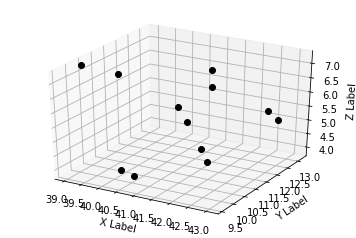

In [62]:
%matplotlib inline

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# ax.scatter(df_111["Position X"], df_111["Position Y"], df_111["Position Z"], marker='o', s=50)
ax.plot(df_111["Position X"], df_111["Position Y"], df_111["Position Z"], 'ko')
# for simplex in hull.simplices:
#     plt.plot(points[simplex, 0], points[simplex, 1], 'k-')
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

plt.show()

In [63]:
pts = np.array([[x,y,z] for (x,y,z) in zip(df_111["Position X"], df_111["Position Y"], df_111["Position Z"])])
pts[:5]

array([[43.04019928, 12.41959953,  5.37830019],
       [43.0257988 , 11.95919991,  5.9278698 ],
       [42.03250122, 10.90359974,  4.36051989],
       [42.24750137, 10.30179977,  5.19831991],
       [40.74250031, 13.15540028,  5.70733976]])

Automatic pdb calling has been turned OFF


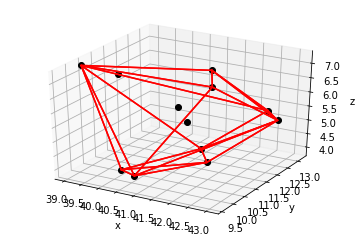

In [65]:
%pdb 0
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.spatial import ConvexHull


# 8 points defining the cube corners
# pts = np.array([[0, 0, 0], [1, 0, 0], [1, 1, 0], [0, 1, 0],
#                 [0, 0, 1], [1, 0, 1], [1, 1, 1], [0, 1, 1], ])

hull = ConvexHull(pts)

fig = plt.figure()
ax = fig.add_subplot(111, projection="3d")

# Plot defining corner points
ax.plot(pts.T[0], pts.T[1], pts.T[2], "ko")
# ax.scatter(df_111["Position X"], df_111["Position Y"], df_111["Position Z"], marker='o', s=50)

# 12 = 2 * 6 faces are the simplices (2 simplices per square face)
for s in hull.simplices:
    s = np.append(s, s[0])  # Here we cycle back to the first coordinate
    ax.plot(pts[s, 0], pts[s, 1], pts[s, 2], "r-")
#     print(s, pts[s,0], pts[s, 1], pts[s,2])

# Make axis label
for i in ["x", "y", "z"]:
    eval("ax.set_{:s}label('{:s}')".format(i, i))

plt.show()

In [66]:
hull.volume

11.03494600561509

In [67]:
import os
import sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)
from ellipsoid_fit import *

In [68]:
center, evecs, radii, v = ellipsoid_fit(pts)

In [69]:
center

array([42.29730856, 11.19822556,  5.09621787])

In [70]:
radii

array([-1.08875092,  0.57654383,  1.17514238])

In [71]:
a, b, c = radii

In [72]:
import math
print("volume:", (4/3) * math.pi * a * b * c)

volume: -3.0898682159506277


/Users/audi/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning:

invalid value encountered in double_scalars



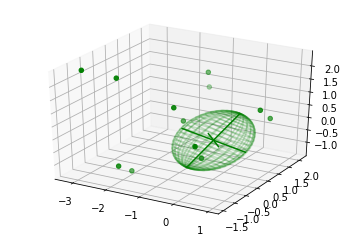

[42.27075299 11.06375806  5.04346227]


In [73]:
data = pts
data2 = data_regularize(data, divs=8)

center, evecs, radii, v = ellipsoid_fit(data2)

data_centered = data - center.T
data_centered_regularized = data2 - center.T

a, b, c = radii
r = (a * b * c) ** (1. / 3.)
D = np.array([[r/a, 0., 0.], [0., r/b, 0.], [0., 0., r/c]])
#http://www.cs.brandeis.edu/~cs155/Lecture_07_6.pdf
#affine transformation from ellipsoid to sphere (translation excluded)
TR = evecs.dot(D).dot(evecs.T)
data_on_sphere = TR.dot(data_centered_regularized.T).T

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

#hack  for equal axes
# ax.set_aspect('equal')
# for direction in (-1, 1):
#     for point in np.diag(direction * np.max(data) * np.array([1, 1, 1])):
#         ax.plot([point[0]], [point[1]], [point[2]], 'w')

ax.scatter(data_centered[:,0], data_centered[:,1], data_centered[:,2], marker='o', color='g')
# ax.scatter(data_centered_regularized[:, 0], data_centered_regularized[:, 1],
#            data_centered_regularized[:, 2], marker='o', color='b')
ax.scatter(data_on_sphere[:, 0], data_on_sphere[:, 1],
           data_on_sphere[:, 2], marker='o', color='r')

ellipsoid_plot([0, 0, 0], radii, evecs, ax=ax, plot_axes=True, cage_color='g')
ellipsoid_plot([0, 0, 0], [r, r, r], evecs, ax=ax, plot_axes=True, cage_color='orange')

#ax.plot([r],[0],[0],color='r',marker='o')
#ax.plot([radii[0]],[0],[0],color='b',marker='o')

plt.show()
print(center)

In [74]:
from scipy.spatial import ConvexHull, convex_hull_plot_2d
import numpy as np
from numpy.linalg import eig, inv

def ls_ellipsoid(xx,yy,zz):                                  
    #finds best fit ellipsoid. Found at http://www.juddzone.com/ALGORITHMS/least_squares_3D_ellipsoid.html
    #least squares fit to a 3D-ellipsoid
    #  Ax^2 + By^2 + Cz^2 +  Dxy +  Exz +  Fyz +  Gx +  Hy +  Iz  = 1
    #
    # Note that sometimes it is expressed as a solution to
    #  Ax^2 + By^2 + Cz^2 + 2Dxy + 2Exz + 2Fyz + 2Gx + 2Hy + 2Iz  = 1
    # where the last six terms have a factor of 2 in them
    # This is in anticipation of forming a matrix with the polynomial coefficients.
    # Those terms with factors of 2 are all off diagonal elements.  These contribute
    # two terms when multiplied out (symmetric) so would need to be divided by two
    
    # change xx from vector of length N to Nx1 matrix so we can use hstack
    x = xx[:,np.newaxis]
    y = yy[:,np.newaxis]
    z = zz[:,np.newaxis]
    
    #  Ax^2 + By^2 + Cz^2 +  Dxy +  Exz +  Fyz +  Gx +  Hy +  Iz = 1
    J = np.hstack((x*x,y*y,z*z,x*y,x*z,y*z, x, y, z))
    K = np.ones_like(x) #column of ones
    
    #np.hstack performs a loop over all samples and creates
    #a row in J for each x,y,z sample:
    # J[ix,0] = x[ix]*x[ix]
    # J[ix,1] = y[ix]*y[ix]
    # etc.
    
    JT=J.transpose()
    JTJ = np.dot(JT,J)
    InvJTJ=np.linalg.inv(JTJ);
    ABC= np.dot(InvJTJ, np.dot(JT,K))

    # Rearrange, move the 1 to the other side
    #  Ax^2 + By^2 + Cz^2 +  Dxy +  Exz +  Fyz +  Gx +  Hy +  Iz - 1 = 0
    #    or
    #  Ax^2 + By^2 + Cz^2 +  Dxy +  Exz +  Fyz +  Gx +  Hy +  Iz + J = 0
    #  where J = -1
    eansa=np.append(ABC,-1)

    return (eansa)

def polyToParams3D(vec,printMe):                             
    #gets 3D parameters of an ellipsoid. Found at http://www.juddzone.com/ALGORITHMS/least_squares_3D_ellipsoid.html
    # convert the polynomial form of the 3D-ellipsoid to parameters
    # center, axes, and transformation matrix
    # vec is the vector whose elements are the polynomial
    # coefficients A..J
    # returns (center, axes, rotation matrix)
    
    #Algebraic form: X.T * Amat * X --> polynomial form
    
    if printMe: print('\npolynomial\n',vec)
    
    Amat=np.array(
    [
    [ vec[0],     vec[3]/2.0, vec[4]/2.0, vec[6]/2.0 ],
    [ vec[3]/2.0, vec[1],     vec[5]/2.0, vec[7]/2.0 ],
    [ vec[4]/2.0, vec[5]/2.0, vec[2],     vec[8]/2.0 ],
    [ vec[6]/2.0, vec[7]/2.0, vec[8]/2.0, vec[9]     ]
    ])
    
    if printMe: print('\nAlgebraic form of polynomial\n',Amat)
    
    #See B.Bartoni, Preprint SMU-HEP-10-14 Multi-dimensional Ellipsoidal Fitting
    # equation 20 for the following method for finding the center
    A3=Amat[0:3,0:3]
    A3inv=inv(A3)
    ofs=vec[6:9]/2.0
    center=-np.dot(A3inv,ofs)
    if printMe: print('\nCenter at:',center)
    
    # Center the ellipsoid at the origin
    Tofs=np.eye(4)
    Tofs[3,0:3]=center
    R = np.dot(Tofs,np.dot(Amat,Tofs.T))
    if printMe: print('\nAlgebraic form translated to center\n',R,'\n')
    
    R3=R[0:3,0:3]
    R3test=R3/R3[0,0]
    # print('normed \n',R3test)
    s1=-R[3, 3]
    R3S=R3/s1
    (el,ec)=eig(R3S)
    
    recip=1.0/np.abs(el)
    axes=np.sqrt(recip)
    if printMe: print('\nAxes are\n',axes  ,'\n')
    
    inve=inv(ec) #inverse is actually the transpose here
    if printMe: print('\nRotation matrix\n',inve)
    return (center,axes,inve)


#let us assume some definition of x, y and z

#get convex hull
# surface  = np.stack((conf.x,conf.y,conf.z), axis=-1)
surface = pts
hullV    = ConvexHull(surface)
lH       = len(hullV.vertices)
hull     = np.zeros((lH,3))
for i in range(len(hullV.vertices)):
    hull[i] = surface[hullV.vertices[i]]
hull     = np.transpose(hull)         
            
#fit ellipsoid on convex hull
eansa            = ls_ellipsoid(hull[0],hull[1],hull[2]) #get ellipsoid polynomial coefficients
print("coefficients:"  , eansa)
center,axes,inve = polyToParams3D(eansa,False)   #get ellipsoid 3D parameters
print("center:"        , center)
print("axes:"          , axes)
print("rotationMatrix:", inve)

coefficients: [-7.23079976e-04 -2.20602615e-05  1.54444871e-04  4.43715414e-04
  3.43437998e-04 -7.93131303e-04  5.29378951e-02 -1.35894418e-02
 -6.50343861e-03 -1.00000000e+00]
center: [41.55767867 11.91888333  5.45240547]
axes: [1.20870172 2.57515398 1.6413261 ]
rotationMatrix: [[ 0.88426094 -0.36629948 -0.28966754]
 [-0.46697244 -0.68772374 -0.55585322]
 [-0.0043975  -0.62678605  0.779179  ]]


In [75]:
# !pip install simpy

In [76]:
%pdb 0
from scipy.spatial import Delaunay
import numpy as np
from collections import defaultdict

def alpha_shape_3D(pos, alpha):
    """
    Compute the alpha shape (concave hull) of a set of 3D points.
    Parameters:
        pos - np.array of shape (n,3) points.
        alpha - alpha value.
    return
        outer surface vertex indices, edge indices, and triangle indices
    """

    tetra = Delaunay(pos)
    # Find radius of the circumsphere.
    # By definition, radius of the sphere fitting inside the tetrahedral needs 
    # to be smaller than alpha value
    # http://mathworld.wolfram.com/Circumsphere.html
    tetrapos = np.take(pos,tetra.vertices,axis=0)
    normsq = np.sum(tetrapos**2,axis=2)[:,:,None]
    ones = np.ones((tetrapos.shape[0],tetrapos.shape[1],1))
    a = np.linalg.det(np.concatenate((tetrapos,ones),axis=2))
    Dx = np.linalg.det(np.concatenate((normsq,tetrapos[:,:,[1,2]],ones),axis=2))
    Dy = -np.linalg.det(np.concatenate((normsq,tetrapos[:,:,[0,2]],ones),axis=2))
    Dz = np.linalg.det(np.concatenate((normsq,tetrapos[:,:,[0,1]],ones),axis=2))
    c = np.linalg.det(np.concatenate((normsq,tetrapos),axis=2))
    r = np.sqrt(Dx**2+Dy**2+Dz**2-4*a*c)/(2*np.abs(a))

#     print(r)
    
    # Find tetrahedrals
    tetras = tetra.vertices[r<alpha,:]
    # triangles
    TriComb = np.array([(0, 1, 2), (0, 1, 3), (0, 2, 3), (1, 2, 3)])
    Triangles = tetras[:,TriComb].reshape(-1,3)
    Triangles = np.sort(Triangles,axis=1)
    # Remove triangles that occurs twice, because they are within shapes
    TrianglesDict = defaultdict(int)
    for tri in Triangles:TrianglesDict[tuple(tri)] += 1
    Triangles=np.array([tri for tri in TrianglesDict if TrianglesDict[tri] ==1])
    #edges
    EdgeComb=np.array([(0, 1), (0, 2), (1, 2)])
    Edges=Triangles[:,EdgeComb].reshape(-1,2)
    Edges=np.sort(Edges,axis=1)
    Edges=np.unique(Edges,axis=0)

    Vertices = np.unique(Edges)
    return Vertices,Edges,Triangles

Automatic pdb calling has been turned OFF


In [77]:
pts.shape

(12, 3)

In [78]:
%pdb 0
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.spatial import ConvexHull

def plot(pts, triangles):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection="3d")
    ax.plot(pts.T[0], pts.T[1], pts.T[2], "ko")
    for s in triangles:
        s = np.append(s, s[0])  # Here we cycle back to the first coordinate
        ax.plot(pts[s, 0], pts[s, 1], pts[s, 2], "r-")
    for i in ["x", "y", "z"]:
        eval("ax.set_{:s}label('{:s}')".format(i, i))
    plt.show()

Automatic pdb calling has been turned OFF


In [79]:
nb_vertices = []
for i in np.arange(1.2,5.0,0.1):
    vertices, edges, triangles = alpha_shape_3D(pts, i)
    nb_vertices.append(len(vertices))

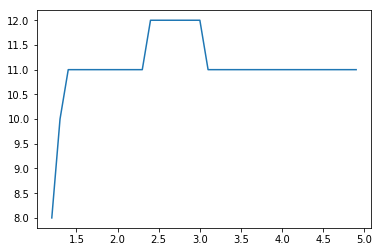

In [80]:
plt.plot(np.arange(1.2,5.0,0.1), nb_vertices)
plt.show()

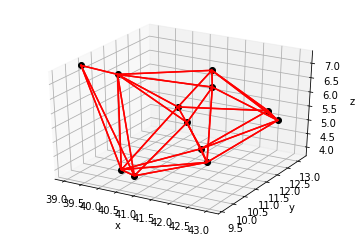

In [81]:
%matplotlib inline
vertices, edges, triangles = alpha_shape_3D(pts, 2.5)
plot(pts, triangles)

In [82]:
import mpl_toolkits.mplot3d as a3
import matplotlib.colors as colors
import pylab as pl
import scipy as sp

In [83]:
def plot_colored(pts, triangles):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection="3d")
    ax.plot(pts.T[0], pts.T[1], pts.T[2], "ko")
    for s in triangles:
        s = np.append(s, s[0])  # Here we cycle back to the first coordinate
#         ax.plot(pts[s, 0], pts[s, 1], pts[s, 2], "r-")
        vtx = [pts[i] for i in s]
        tri = a3.art3d.Poly3DCollection([vtx])
        tri.set_color(colors.rgb2hex(sp.rand(3)))
        tri.set_edgecolor('k')
#         ax.add_collection3d(tri)
        ax.add_collection3d(a3.art3d.Poly3DCollection([vtx], 
#                                                       facecolors='w', 
                                                      facecolors=colors.rgb2hex(sp.rand(3)),
                                                      linewidths=1, alpha=0.5))
        ax.add_collection3d(a3.art3d.Line3DCollection([vtx], colors='k', linewidths=0.2, linestyles=':'))
    for i in ["x", "y", "z"]:
        eval("ax.set_{:s}label('{:s}')".format(i, i))
    plt.show()

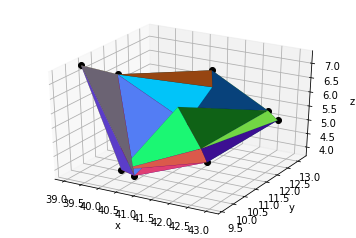

In [84]:
plot_colored(pts, triangles)

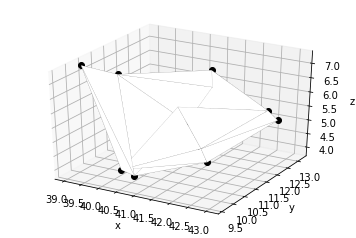

In [32]:
plot_colored(pts, triangles)

In [33]:
points = np.array([[0, 0], [0, 1.1], [1, 0], [1, 1]])
from scipy.spatial import Delaunay

In [34]:
tri_pts = Delaunay(pts)

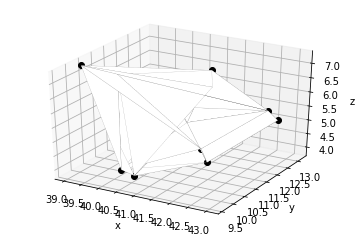

In [35]:
plot_colored(pts, tri_pts.simplices)

In [36]:
tri_pts.npoints

12

In [37]:
# Import dependencies
import plotly
import plotly.graph_objs as go

# Configure Plotly to be rendered inline in the notebook.
plotly.offline.init_notebook_mode()

# Configure the trace.
trace = go.Scatter3d(
    x=[1, 2, 3],  # <-- Put your data instead
    y=[4, 5, 6],  # <-- Put your data instead
    z=[7, 8, 9],  # <-- Put your data instead
    mode='markers',
    marker={
        'size': 10,
        'opacity': 0.8,
    }
)

# Configure the layout.
layout = go.Layout(
    margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
)

data = [trace]

plot_figure = go.Figure(data=data, layout=layout)

# Render the plot.
plotly.offline.iplot(plot_figure)

In [38]:
x = pts[:,0]
y = pts[:,1]
z = pts[:,2]

In [39]:
fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z,
                                   mode='markers')])
fig.show()

In [40]:
import plotly.graph_objects as go
import numpy as np
from plotly.subplots import make_subplots

# pts = np.loadtxt(np.DataSource().open('https://raw.githubusercontent.com/plotly/datasets/master/mesh_dataset.txt'))
# x, y, z = pts.T

trace1 = go.Mesh3d(x=x, y=y, z=z,
                   alphahull=2,
                   opacity=0.4,
                   color='cyan')
trace2 = go.Scatter3d(x=x, y=y, z=z,
                                   mode='markers+text', 
                           text=df_111["chromosome pairs"])

# trace1 = go.Figure(data=[])
# trace2 = go.Figure(data=[])

fig = make_subplots()
fig.add_trace(trace1)
fig.add_trace(trace2)
# fig['layout'].update(height = 600, width = 800, title = title,xaxis=dict(
#       tickangle=-90
#     ))
# iplot(fig)
fig.show()

KeyError: 'chromosome pairs'

In [41]:
trace1

Mesh3d({
    'alphahull': 2,
    'color': 'cyan',
    'opacity': 0.4,
    'x': array([43.04019928, 43.0257988 , 42.03250122, 42.24750137, 40.74250031,
                40.95750046, 39.02899933, 39.77320099, 40.37559891, 40.48899841,
                41.0685997 , 41.25450134]),
    'y': array([12.41959953, 11.95919991, 10.90359974, 10.30179977, 13.15540028,
                12.77779961, 10.2031002 , 10.57789993, 10.29259968,  9.61437988,
                11.5255003 , 10.84969997]),
    'z': array([5.37830019, 5.9278698 , 4.36051989, 5.19831991, 5.70733976, 6.51293993,
                7.3499999 , 7.05000019, 3.75      , 4.3499999 , 5.25      , 6.1500001 ])
})

In [42]:
fig = make_subplots()
for s in triangles:
    s = np.append(s, s[0])  
    vtx = np.array([pts[i] for i in s])
    trace = go.Mesh3d(
        x=vtx[:,0],
        y=vtx[:,1],
        z=vtx[:,2],
#         colorbar_title='z',
#         colorscale=[[0, 'gold'],
#                     [0.5, 'mediumturquoise'],
#                     [1, 'magenta']],
        # Intensity of each vertex, which will be interpolated and color-coded
#         intensity=[0, 0.33, 0.66, 1],
        # i, j and k give the vertices of triangles
        # here we represent the 4 triangles of the tetrahedron surface
        i=[0, 0, 0, 1],
        j=[1, 2, 3, 2],
        k=[2, 3, 1, 3],
        name='y',
#         opacity=0.7,
#         vertexcolor=['rgb(255, 0, 0)']
#         color='white'
#         showscale=True

    )
    fig.add_trace(trace)
fig.add_trace(go.Scatter3d(x=pts[:,0], y=pts[:,1], z=pts[:,2],
                                   mode='markers+text', 
#                            text=df_111["chromosome pairs"]))
                           text=[str(i) for i in range(len(pts))],))
# fig['layout'].update(height = 600, width = 800, title = title,xaxis=dict(
#       tickangle=-90
#     ))
# iplot(fig)
fig.show()

In [43]:
triangles

array([[ 0,  4,  5],
       [ 0,  1,  5],
       [ 1,  5, 11],
       [ 5,  7, 11],
       [ 7,  9, 11],
       [ 4,  7, 10],
       [ 4,  5,  7],
       [ 6,  7,  9],
       [ 6,  7,  8],
       [ 6,  8,  9],
       [ 7,  8, 10],
       [ 3,  9, 11],
       [ 1,  3, 11],
       [ 2,  8,  9],
       [ 2,  8, 10],
       [ 2,  3,  9],
       [ 2,  4, 10],
       [ 0,  2,  4],
       [ 0,  2,  3],
       [ 0,  1,  3]], dtype=int32)

In [44]:
for i in range(len(triangles)-1):
    for j in range(len(triangles[i+1:])):
        same_elmts = list(set(triangles[i])&set(triangles[j]))
        if len(same_elmts) == 2:
#             print(triangles[j], same_elmts)
            idx0_i = np.where(triangles[i] == same_elmts[0])[0][0]
            idx1_i = np.where(triangles[i] == same_elmts[1])[0][0]
            idx_other_i = np.where((triangles[i] != same_elmts[0]) & (triangles[i] != same_elmts[1]))[0][0]
            idx_other_j = np.where((triangles[j] != same_elmts[0]) & (triangles[j] != same_elmts[1]))[0][0]
            other_j = triangles[j][idx_other_j]
            new_triangle = [-1,-1,-1]
            new_triangle[idx0_i] = same_elmts[1]
            new_triangle[idx1_i] = same_elmts[0]
            new_triangle[idx_other_i] = other_j
#             print(new_triangle)
            triangles[j] = new_triangle

In [45]:
triangles

array([[ 0,  4,  5],
       [ 5,  1,  0],
       [ 1,  5, 11],
       [ 5, 11,  7],
       [11,  7,  9],
       [ 4, 10,  7],
       [ 7,  4,  5],
       [ 6,  9,  7],
       [ 7,  8,  6],
       [ 9,  6,  8],
       [ 8,  7, 10],
       [ 9,  3, 11],
       [11,  3,  1],
       [ 2,  8,  9],
       [ 2,  8, 10],
       [ 2,  3,  9],
       [ 2,  4, 10],
       [ 4,  0,  2],
       [ 0,  2,  3],
       [ 0,  1,  3]], dtype=int32)

In [46]:
from queue import Queue

next_tri = Queue()
remaining_tri = Queue()
for tri in triangles:
    remaining_tri.put(tri)

In [47]:
def switch(cur_tri, tri, same_elmts):
    idx0_i = np.where(cur_tri == same_elmts[0])[0][0]
    idx1_i = np.where(cur_tri == same_elmts[1])[0][0]
    idx_other_i = np.where((cur_tri != same_elmts[0]) & (cur_tri != same_elmts[1]))[0][0]
    idx_other_j = np.where((tri != same_elmts[0]) & (tri != same_elmts[1]))[0][0]
    other_j = tri[idx_other_j]
    new_triangle = [-1,-1,-1]
    new_triangle[idx0_i] = same_elmts[1]
    new_triangle[idx1_i] = same_elmts[0]
    new_triangle[idx_other_i] = other_j
    return new_triangle

In [48]:
res = []
while not remaining_tri.empty() or not next_tri.empty():
    print("-----")
    print(next_tri.qsize(), remaining_tri.qsize(), len(res))
    if next_tri.empty():
        next_tri.put(remaining_tri.get())
    new_remain = Queue()
    cur_tri = next_tri.get()
    res.append(cur_tri)
    while not remaining_tri.empty():
        tri = remaining_tri.get()
        same_elmts = list(set(cur_tri)&set(tri))
        if len(same_elmts) < 2:
            new_remain.put(tri)
        else:
            new_tri = switch(cur_tri, tri, same_elmts)
#             res.append(new_tri)
            next_tri.put(new_tri)
    remaining_tri = new_remain
    print(next_tri.qsize(), remaining_tri.qsize(), len(res), next_tri.qsize() + remaining_tri.qsize() + len(res))

-----
0 20 0
3 16 1 20
-----
3 16 1
4 14 2 20
-----
4 14 2
5 12 3 20
-----
5 12 3
6 10 4 20
-----
6 10 4
6 9 5 20
-----
6 9 5
5 9 6 20
-----
5 9 6
5 8 7 20
-----
5 8 7
5 7 8 20
-----
5 7 8
5 6 9 20
-----
5 6 9
5 5 10 20
-----
5 5 10
5 4 11 20
-----
5 4 11
5 3 12 20
-----
5 3 12
5 2 13 20
-----
5 2 13
5 1 14 20
-----
5 1 14
4 1 15 20
-----
4 1 15
3 1 16 20
-----
3 1 16
3 0 17 20
-----
3 0 17
2 0 18 20
-----
2 0 18
1 0 19 20
-----
1 0 19
0 0 20 20


In [49]:
len(triangles), len(res), res

(20,
 20,
 [array([0, 4, 5], dtype=int32),
  [5, 1, 0],
  [7, 5, 4],
  [4, 0, 2],
  [1, 5, 11],
  [3, 0, 1],
  [5, 7, 11],
  [4, 10, 7],
  [2, 10, 4],
  [3, 2, 0],
  [11, 3, 1],
  [9, 11, 7],
  [8, 7, 10],
  [10, 2, 8],
  [2, 3, 9],
  [3, 11, 9],
  [7, 6, 9],
  [7, 8, 6],
  [9, 8, 2],
  [8, 9, 6]])

In [47]:
for i in range(len(res)-1):
    for j in range(len(res[i+1:])):
        same_elmts = list(set(res[i])&set(res[j]))
        if len(same_elmts) == 2:
            idx0_i = np.where(res[i] == same_elmts[0])[0][0]
            idx1_i = np.where(res[i] == same_elmts[1])[0][0]
            idx0_j = np.where(res[j] == same_elmts[0])[0][0]
            idx1_j = np.where(res[j] == same_elmts[1])[0][0]
            if (idx0_i < idx1_i and idx0_j < idx0_i) or \
                (idx0_i > idx1_i and idx0_j > idx0_i):
                    print(res[i], res[j])

[11, 0, 1] [11, 10, 0]


In [48]:
triangles = np.array(res)

In [50]:
fig = make_subplots()
for s in triangles:
    s = np.append(s, s[0])  
    vtx = np.array([pts[i] for i in s])
    trace = go.Mesh3d(
        x=vtx[:,0],
        y=vtx[:,1],
        z=vtx[:,2],
#         colorbar_title='z',
#         colorscale=[[0, 'gold'],
#                     [0.5, 'mediumturquoise'],
#                     [1, 'magenta']],
        # Intensity of each vertex, which will be interpolated and color-coded
#         intensity=[0, 0.33, 0.66, 1],
        # i, j and k give the vertices of triangles
        # here we represent the 4 triangles of the tetrahedron surface
        i=[0, 0, 0, 1],
        j=[1, 2, 3, 2],
        k=[2, 3, 1, 3],
        name='y',
#         opacity=0.7,
#         vertexcolor=['rgb(255, 0, 0)']
#         color='white'
#         showscale=True

    )
    fig.add_trace(trace)
fig.add_trace(go.Scatter3d(x=pts[:,0], y=pts[:,1], z=pts[:,2],
                                   mode='markers+text', 
#                            text=df_111["chromosome pairs"]))
                           text=[str(i) for i in range(len(pts))],))
# fig['layout'].update(height = 600, width = 800, title = title,xaxis=dict(
#       tickangle=-90
#     ))
# iplot(fig)
fig.show()

https://math.stackexchange.com/questions/803076/how-to-calculate-volume-of-non-convex-polyhedron
Here is a slightly more efficient solution assuming that each face Φ of 𝑃 is a triangle. First, you have to orient faces of 𝑃 as above. For each face Φ=𝐴𝐵𝐶 of 𝑃 define the determinant
𝑑(Φ)=det(𝐴,𝐵,𝐶)
where vectors 𝐴,𝐵,𝐶 are columns of the 3-by-3 matrix whose determinant we are computing. Then
𝑣𝑜𝑙(𝑃)=∣∣∣∣∑Φ𝑑(Φ)/6∣∣∣∣.

In [51]:
def compute_volume(pts, triangles):
    volume = 0
    for tri in triangles:
        face = pts[tri].transpose()
        volume += np.linalg.det(face)/6
    volume = abs(volume)    
    return volume

In [53]:
compute_volume(pts, triangles)

18.935967855859154

In [54]:
pts_cube = np.array([[0, 0, 0], [1, 0, 0], [1, 1, 0], [0, 1, 0], [0, 0, 1], [1, 0, 1], [1, 1, 1], [0, 1, 1]])

In [55]:
%pdb 0
from scipy.spatial import Delaunay
import numpy as np
from collections import defaultdict

def alpha_shape_3D_autoalpha(pos):
    """
    Compute the alpha shape (concave hull) of a set of 3D points.
    Parameters:
        pos - np.array of shape (n,3) points.
        alpha - alpha value.
    return
        outer surface vertex indices, edge indices, and triangle indices
    """

    tetra = Delaunay(pos)
    # Find radius of the circumsphere.
    # By definition, radius of the sphere fitting inside the tetrahedral needs 
    # to be smaller than alpha value
    # http://mathworld.wolfram.com/Circumsphere.html
    tetrapos = np.take(pos,tetra.vertices,axis=0)
    normsq = np.sum(tetrapos**2,axis=2)[:,:,None]
    ones = np.ones((tetrapos.shape[0],tetrapos.shape[1],1))
    a = np.linalg.det(np.concatenate((tetrapos,ones),axis=2))
    Dx = np.linalg.det(np.concatenate((normsq,tetrapos[:,:,[1,2]],ones),axis=2))
    Dy = -np.linalg.det(np.concatenate((normsq,tetrapos[:,:,[0,2]],ones),axis=2))
    Dz = np.linalg.det(np.concatenate((normsq,tetrapos[:,:,[0,1]],ones),axis=2))
    c = np.linalg.det(np.concatenate((normsq,tetrapos),axis=2))
    r = np.sqrt(Dx**2+Dy**2+Dz**2-4*a*c)/(2*np.abs(a))

    
    
    # Find tetrahedrals
    tetras = tetra.vertices[r<alpha,:]
    # triangles
    TriComb = np.array([(0, 1, 2), (0, 1, 3), (0, 2, 3), (1, 2, 3)])
    Triangles = tetras[:,TriComb].reshape(-1,3)
    Triangles = np.sort(Triangles,axis=1)
    # Remove triangles that occurs twice, because they are within shapes
    TrianglesDict = defaultdict(int)
    for tri in Triangles:TrianglesDict[tuple(tri)] += 1
    Triangles=np.array([tri for tri in TrianglesDict if TrianglesDict[tri] ==1])
    #edges
    EdgeComb=np.array([(0, 1), (0, 2), (1, 2)])
    Edges=Triangles[:,EdgeComb].reshape(-1,2)
    Edges=np.sort(Edges,axis=1)
    Edges=np.unique(Edges,axis=0)

    Vertices = np.unique(Edges)
    return Vertices,Edges,Triangles

Automatic pdb calling has been turned OFF


In [56]:
pos = pts_cube

In [57]:
tetra = Delaunay(pos)
# Find radius of the circumsphere.
# By definition, radius of the sphere fitting inside the tetrahedral needs 
# to be smaller than alpha value
# http://mathworld.wolfram.com/Circumsphere.html
tetrapos = np.take(pos,tetra.vertices,axis=0)
normsq = np.sum(tetrapos**2,axis=2)[:,:,None]
ones = np.ones((tetrapos.shape[0],tetrapos.shape[1],1))
a = np.linalg.det(np.concatenate((tetrapos,ones),axis=2))
Dx = np.linalg.det(np.concatenate((normsq,tetrapos[:,:,[1,2]],ones),axis=2))
Dy = -np.linalg.det(np.concatenate((normsq,tetrapos[:,:,[0,2]],ones),axis=2))
Dz = np.linalg.det(np.concatenate((normsq,tetrapos[:,:,[0,1]],ones),axis=2))
c = np.linalg.det(np.concatenate((normsq,tetrapos),axis=2))
r = np.sqrt(Dx**2+Dy**2+Dz**2-4*a*c)/(2*np.abs(a))

In [58]:
sorted_r = sorted(list(set(r)))

In [59]:
sorted_r

[0.8660254037844387, 0.8660254037844388]

In [60]:
for i in range(len(sorted_r)):
    if i == len(sorted_r) - 1:
        diff = 0.1
    else:
        diff = (sorted_r[i+1] - sorted_r[i])/2
    alpha = sorted_r[i] + diff
    # Find tetrahedrals
    tetras = tetra.vertices[r<alpha,:]
    # triangles
    TriComb = np.array([(0, 1, 2), (0, 1, 3), (0, 2, 3), (1, 2, 3)])
    Triangles = tetras[:,TriComb].reshape(-1,3)
    Triangles = np.sort(Triangles,axis=1)
    # Remove triangles that occurs twice, because they are within shapes
    TrianglesDict = defaultdict(int)
    for tri in Triangles:TrianglesDict[tuple(tri)] += 1
    Triangles=np.array([tri for tri in TrianglesDict if TrianglesDict[tri] ==1])
    #edges
    EdgeComb=np.array([(0, 1), (0, 2), (1, 2)])
    Edges=Triangles[:,EdgeComb].reshape(-1,2)
    Edges=np.sort(Edges,axis=1)
    Edges=np.unique(Edges,axis=0)
    Vertices = np.unique(Edges)
    print(f"alpha:{alpha}, nb_vertices:{len(Vertices)}, nb_pos:{len(pos)}")
    if len(Vertices) == len(pos):
        print("alpha:", alpha)
        break;
#     return Vertices,Edges,Triangles

alpha:0.8660254037844388, nb_vertices:7, nb_pos:8
alpha:0.9660254037844388, nb_vertices:8, nb_pos:8
alpha: 0.9660254037844388


In [61]:
def plot_alphashape(pts, triangles, text=None):
    if text is None:
        text = [str(i) for i in range(len(pts))]
    fig = make_subplots()
    for s in triangles:
        s = np.append(s, s[0])  
        vtx = np.array([pts[i] for i in s])
        trace = go.Mesh3d(
            x=vtx[:,0],
            y=vtx[:,1],
            z=vtx[:,2],
            i=[0, 0, 0, 1],
            j=[1, 2, 3, 2],
            k=[2, 3, 1, 3],
            name='y',
        )
        fig.add_trace(trace)
    fig.add_trace(go.Scatter3d(x=pts[:,0], y=pts[:,1], z=pts[:,2],
                                       mode='markers+text', 
                               text=text))
    return fig

In [62]:
fig = plot_alphashape(pts_cube, Triangles)
fig.show()

In [63]:
Triangles

array([[1, 2, 6],
       [0, 1, 2],
       [0, 1, 4],
       [2, 3, 6],
       [0, 2, 3],
       [0, 3, 4],
       [4, 5, 6],
       [1, 5, 6],
       [1, 4, 5],
       [3, 6, 7],
       [4, 6, 7],
       [3, 4, 7]], dtype=int32)

In [64]:
def orient_faces(triangles):
    # -- prepare queues     
    next_tri = Queue()
    remaining_tri = Queue()
    for tri in triangles:
        remaining_tri.put(tri)
    # -- process triangles
    res = []
    while not remaining_tri.empty() or not next_tri.empty():
        if next_tri.empty():
            next_tri.put(remaining_tri.get())
        new_remain = Queue()
        cur_tri = next_tri.get()
        res.append(cur_tri)
        while not remaining_tri.empty():
            tri = remaining_tri.get()
            same_elmts = list(set(cur_tri)&set(tri))
            if len(same_elmts) < 2:
                new_remain.put(tri)
            else:
                new_tri = switch(cur_tri, tri, same_elmts)
                next_tri.put(new_tri)
        remaining_tri = new_remain
    return res

In [65]:
triangles = orient_faces(Triangles)

In [66]:
fig = plot_alphashape(pts_cube, triangles)
fig.show()

In [67]:
compute_volume(pts_cube, triangles)

0.9999999999999999

# TESTING STARTS HERE

In [44]:
import pandas as pd
from scipy.spatial import Delaunay
import numpy as np
from collections import defaultdict
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from queue import Queue

def alpha_shape_3d_autoalpha(pos):
    """
    Based on: https://stackoverflow.com/questions/26303878/alpha-shapes-in-3d
    Compute the alpha shape (concave hull) of a set of 3D points.
    Alpha value is computed automatically to include all points as vertices.
    Parameters:
        pos - np.array of shape (n,3) points.
    return
        outer surface vertex indices, edge indices, and triangle indices
    """

    tetra = Delaunay(pos)
    # Find radius of the circumsphere.
    # By definition, radius of the sphere fitting inside the tetrahedral needs
    # to be smaller than alpha value
    # http://mathworld.wolfram.com/Circumsphere.html
    tetrapos = np.take(pos, tetra.vertices, axis=0)
    normsq = np.sum(tetrapos ** 2, axis=2)[:, :, None]
    ones = np.ones((tetrapos.shape[0], tetrapos.shape[1], 1))
    a = np.linalg.det(np.concatenate((tetrapos, ones), axis=2))
    Dx = np.linalg.det(np.concatenate((normsq, tetrapos[:, :, [1, 2]], ones), axis=2))
    Dy = -np.linalg.det(np.concatenate((normsq, tetrapos[:, :, [0, 2]], ones), axis=2))
    Dz = np.linalg.det(np.concatenate((normsq, tetrapos[:, :, [0, 1]], ones), axis=2))
    c = np.linalg.det(np.concatenate((normsq, tetrapos), axis=2))
    r = np.sqrt(Dx ** 2 + Dy ** 2 + Dz ** 2 - 4 * a * c) / (2 * np.abs(a))

#     print(r)
    sorted_r = sorted(list(set(r)))[::-1]
#     print(sorted_r)

    for i in range(len(sorted_r)):
        if i == len(sorted_r) - 1:
            diff = 0.1
        else:
            diff = (sorted_r[i + 1] - sorted_r[i]) / 2
        alpha = sorted_r[i] + diff
        # Find tetrahedrals
        tetras = tetra.vertices[r < alpha, :]
        # triangles
        TriComb = np.array([(0, 1, 2), (0, 1, 3), (0, 2, 3), (1, 2, 3)])
        Triangles = tetras[:, TriComb].reshape(-1, 3)
        Triangles = np.sort(Triangles, axis=1)
        # Remove triangles that occurs twice, because they are within shapes
        TrianglesDict = defaultdict(int)
        for tri in Triangles:
            TrianglesDict[tuple(tri)] += 1
        Triangles = np.array([tri for tri in TrianglesDict if TrianglesDict[tri] == 1])
        # edges
        EdgeComb = np.array([(0, 1), (0, 2), (1, 2)])
        Edges = Triangles[:, EdgeComb].reshape(-1, 2)
        Edges = np.sort(Edges, axis=1)
        Edges = np.unique(Edges, axis=0)
        Vertices = np.unique(Edges)
        if len(Vertices) == len(pos):
            break

    return Vertices, Edges, Triangles

def plot_alphashape(pts, triangles, text=None):
    if text is None:
        text = [str(i) for i in range(len(pts))]
    fig = make_subplots()
    minx = miny = minz = 999999999
    maxx = maxy = maxz = -999999999
    for s in triangles:
        s = np.append(s, s[0])
        vtx = np.array([pts[i] for i in s])
        trace = go.Mesh3d(
            x=vtx[:, 0],
            y=vtx[:, 1],
            z=vtx[:, 2],
            i=[0, 0, 0, 1],
            j=[1, 2, 3, 2],
            k=[2, 3, 1, 3],
            name="y",
#             opacity=0.7
        )
        minx = min(minx, min(x))
        miny = min(miny, min(y))
        minz = min(minz, min(z))
        maxx = max(maxx, max(x))
        maxy = max(maxy, max(y))
        maxz = max(maxz, max(z))
        fig.add_trace(trace)
    fig.add_trace(
        go.Scatter3d(
            x=pts[:, 0], y=pts[:, 1], z=pts[:, 2], mode="markers+text", text=text
        )
    )
    return fig, (minx, miny, minz, maxx, maxy, maxz)

def switch(cur_tri, tri, same_elmts):
    idx0_i = np.where(cur_tri == same_elmts[0])[0][0]
    idx1_i = np.where(cur_tri == same_elmts[1])[0][0]
    idx_other_i = np.where((cur_tri != same_elmts[0]) & (cur_tri != same_elmts[1]))[0][0]
    idx_other_j = np.where((tri != same_elmts[0]) & (tri != same_elmts[1]))[0][0]
    other_j = tri[idx_other_j]
    new_triangle = [-1,-1,-1]
    new_triangle[idx0_i] = same_elmts[1]
    new_triangle[idx1_i] = same_elmts[0]
    new_triangle[idx_other_i] = other_j
    return new_triangle    

def orient_faces(triangles):
    # -- prepare queues     
    next_tri = Queue()
    remaining_tri = Queue()
    for tri in triangles:
        remaining_tri.put(tri)
    # -- process triangles
    res = []
    while not remaining_tri.empty() or not next_tri.empty():
        if next_tri.empty():
            next_tri.put(remaining_tri.get())
        new_remain = Queue()
        cur_tri = next_tri.get()
        res.append(cur_tri)
        while not remaining_tri.empty():
            tri = remaining_tri.get()
            same_elmts = list(set(cur_tri)&set(tri))
            if len(same_elmts) < 2:
                new_remain.put(tri)
            else:
                new_tri = switch(cur_tri, tri, same_elmts)
                next_tri.put(new_tri)
        remaining_tri = new_remain
    return res

def compute_volume(pts, triangles, re_orient=True):
    """https://math.stackexchange.com/questions/803076/how-to-calculate-volume-of-non-convex-polyhedron"""
    if re_orient:
        triangles = orient_faces(triangles)
    volume = 0
    for tri in triangles:
        face = pts[tri].transpose()
        volume += np.linalg.det(face)/6
    volume = abs(volume)    
    return volume

In [2]:
# input_file = "/Users/audi/Downloads/JDU233_31Z_30X_10s_04 congression measure.xlsx"
input_file = "/Users/audi/Downloads/191017_14 pm congression measure.xlsx"
sheet_name = "position chromosome"

In [3]:
df = pd.read_excel(input_file, sheet_name=sheet_name, header=1)
df.head()

,Position X,Position Y,Position Z,Time,chromosomes pairs,X,Y,Z,X.1,Y.1,Z.1
0,49.987499,8.34553,5.11202,1,1M,0.645000,-0.598539,0.27341,50.309999,8.046260,5.248725
1,50.632500,7.74699,5.38543,1,1PB,NaN,NaN,NaN,NaN,NaN,NaN
2,48.267502,6.63995,4.52075,1,2M,0.429996,-0.332070,0.82561,48.482500,6.473915,4.933555
3,48.697498,6.30788,5.34636,1,2PB,NaN,NaN,NaN,NaN,NaN,NaN
4,52.631500,8.60928,6.09266,1,3M,-0.180500,-0.692590,0.05734,52.541250,8.262985,6.121330


In [4]:
df= df[df["Time"] == 24]
df.head()

,Position X,Position Y,Position Z,Time,chromosomes pairs,X,Y,Z,X.1,Y.1,Z.1
276,43.040199,12.4196,5.37830,24,1M,-0.0144,-0.460400,0.54957,43.032999,12.1894,5.653085
277,43.025799,11.9592,5.92787,24,1PB,NaN,NaN,NaN,NaN,NaN,NaN
278,42.032501,10.9036,4.36052,24,2M,0.2150,-0.601800,0.83780,42.140001,10.6027,4.779420
279,42.247501,10.3018,5.19832,24,2PB,NaN,NaN,NaN,NaN,NaN,NaN
280,40.742500,13.1554,5.70734,24,3M,0.2150,-0.377601,0.80560,40.850000,12.9666,6.110140


In [5]:
x = df.iloc[:, 0]
y = df.iloc[:, 1]
z = df.iloc[:, 2]
pos = np.array(
            [
                np.array(x),
                np.array(y),
                np.array(z),
            ]
        ).transpose()
pos.shape

(12, 3)

In [6]:
_, _, triangles = alpha_shape_3d_autoalpha(pos)

In [45]:
fig, (minx, miny, minz, maxx, maxy, maxz) = plot_alphashape(pos, triangles)
fig.show()

In [46]:
minx, miny, minz, maxx, maxy, maxz

(39.02899932861328,
 9.6143798828125,
 3.75,
 43.040199279785156,
 13.155400276184082,
 7.349999904632568)

In [48]:
maxx-minx

4.011199951171875

In [56]:
x_range = 10
x_diff = (x_range - (maxx-minx))/2
minx -= x_diff
maxx += x_diff

In [57]:
fig.update_layout(
    scene = dict(
        xaxis = dict(range=[minx,maxx]),
        yaxis = dict(range=[miny,maxy]),
        zaxis = dict(range=[minz,maxz])),
#     width=700,
#     margin=dict(r=20, l=10, b=10, t=10)
)

fig.show()

In [38]:
fig.layout.scene

layout.Scene({
    'xaxis': {'range': [30, 50]}, 'yaxis': {'range': [5, 15]}, 'zaxis': {'range': [0, 10]}
})

In [58]:
compute_volume(pos, triangles)

57.66109033988717

## check face orientations

In [59]:
triangles = orient_faces(triangles)

In [60]:
res = triangles
for i in range(len(res)-1):
    for j in range(len(res[i+1:])):
        same_elmts = list(set(res[i])&set(res[j]))
        if len(same_elmts) == 2:
            idx0_i = np.where(res[i] == same_elmts[0])[0][0]
            idx1_i = np.where(res[i] == same_elmts[1])[0][0]
            idx0_j = np.where(res[j] == same_elmts[0])[0][0]
            idx1_j = np.where(res[j] == same_elmts[1])[0][0]
            if (idx0_i < idx1_i and idx0_j < idx0_i) or \
                (idx0_i > idx1_i and idx0_j > idx0_i):
                    print(res[i], res[j])

[3, 0, 1] [3, 2, 0]


## check each tetrahedron volume

In [61]:
total = 0
volumes = []
for tri in triangles:
    face = pos[tri].transpose()
    volume = np.linalg.det(face)/6
    total += volume
    volumes.append(volume)
    print(f"{tri}: {volume} --> {total}")
sorted(volumes)

[0 4 5]: 9.757196619323322 --> 9.757196619323322
[5, 1, 0]: 8.358939475300852 --> 18.116136094624174
[6, 5, 4]: -6.9180486236306535 --> 11.19808747099352
[4, 0, 2]: 3.5337311036005477 --> 14.731818574594069
[1, 5, 11]: 8.508727631281976 --> 23.240546205876043
[3, 0, 1]: 7.736410921927817 --> 30.97695712780386
[5, 6, 7]: 4.520905600987592 --> 35.49786272879145
[4, 7, 6]: -4.865856492039087 --> 30.632006236752368
[2, 8, 4]: 6.068222963426631 --> 36.700229200178995
[3, 2, 0]: 11.374259721811478 --> 48.07448892199047
[7, 11, 5]: 15.131113296549712 --> 63.205602218540186
[11, 3, 1]: 7.571501811115733 --> 70.77710402965592
[9, 7, 6]: 6.618163425439671 --> 77.39526745509559
[8, 7, 6]: 5.269928599017375 --> 82.66519605411297
[7, 4, 10]: -25.15501742258775 --> 57.51017863152522
[8, 2, 9]: 2.921050565479458 --> 60.43122919700468
[10, 4, 8]: -13.083275181261627 --> 47.347954015743056
[2, 3, 9]: 4.388568694148231 --> 51.73652270989129
[11, 7, 9]: 6.6033111316716955 --> 58.339833841562985
[3, 11, 9

[-25.15501742258775,
 -18.732214424863177,
 -13.083275181261627,
 -6.9180486236306535,
 -4.865856492039087,
 -1.5599110453885592,
 2.921050565479458,
 3.5337311036005477,
 4.388568694148231,
 4.520905600987592,
 5.269928599017375,
 6.068222963426631,
 6.6033111316716955,
 6.618163425439671,
 7.571501811115733,
 7.736410921927817,
 8.358939475300852,
 8.508727631281976,
 9.757196619323322,
 11.374259721811478,
 15.131113296549712,
 19.613381968575922]

## Plot one positive tetrahedron

In [130]:
text = [str(i) for i in range(len(pos))]
fig = make_subplots()
s = triangles[-1]
s = np.append(s, s[0])
vtx = np.array([pos[i] for i in s])
trace = go.Mesh3d(
    x=vtx[:, 0],
    y=vtx[:, 1],
    z=vtx[:, 2],
    i=[0, 0, 0, 1],
    j=[1, 2, 3, 2],
    k=[2, 3, 1, 3],
    name="y",
    opacity=1
)
fig.add_trace(trace)
fig.add_trace(
    go.Scatter3d(
        x=pos[:, 0], y=pos[:, 1], z=pos[:, 2], mode="markers+text", text=text
    )
)
fig.show()

In [131]:
vtx

array([[39.77320099, 10.57789993,  7.05000019],
       [40.37559891, 10.29259968,  3.75      ],
       [41.0685997 , 11.5255003 ,  5.25      ],
       [39.77320099, 10.57789993,  7.05000019]])

In [132]:
new_pos = [
    vtx[0],vtx[1],vtx[2],np.array([0,0,0])
]
new_pos = np.array(new_pos)
new_pos

array([[39.77320099, 10.57789993,  7.05000019],
       [40.37559891, 10.29259968,  3.75      ],
       [41.0685997 , 11.5255003 ,  5.25      ],
       [ 0.        ,  0.        ,  0.        ]])

In [133]:
new_triangles = [
    [0,1,2],
    [0,1,3],
    [1,2,3],
    [0,2,3]
]
text = [s[0], s[1], s[2], "zero"]

In [134]:
# text = [str(i) for i in range(len(pos))]
fig = make_subplots()
for s in new_triangles:
# s = triangles[-1]
    s = np.append(s, s[0])
    vtx = np.array([new_pos[i] for i in s])
# for vtx in new_sides:
    trace = go.Mesh3d(
        x=vtx[:, 0],
        y=vtx[:, 1],
        z=vtx[:, 2],
        i=[0, 0, 0, 1],
        j=[1, 2, 3, 2],
        k=[2, 3, 1, 3],
        name="y",
        opacity=1
    )
    fig.add_trace(trace)
fig.add_trace(
    go.Scatter3d(
        x=new_pos[:, 0], y=new_pos[:, 1], z=new_pos[:, 2], mode="markers+text", text=text
    )
)
fig.show()

In [141]:
triangles

[array([0, 4, 5], dtype=int32),
 [5, 1, 0],
 [6, 5, 4],
 [4, 0, 2],
 [1, 5, 11],
 [3, 0, 1],
 [5, 6, 7],
 [4, 7, 6],
 [2, 8, 4],
 [3, 2, 0],
 [7, 11, 5],
 [11, 3, 1],
 [9, 7, 6],
 [8, 7, 6],
 [7, 4, 10],
 [8, 2, 9],
 [10, 4, 8],
 [2, 3, 9],
 [11, 7, 9],
 [3, 11, 9],
 [6, 8, 9],
 [7, 8, 10]]

In [144]:
compute_volume(new_pos, np.array(new_triangles))

19.613381968575922

In [155]:
def compute_vol_tetrahedron(points):
    a, b, c, d = points
    vol = abs((a-d).dot((np.cross((b-d),(c-d)))))/6
    return vol

In [156]:
compute_vol_tetrahedron(new_pos)

19.613381968575926

## Plot one negative tetrahedron

In [161]:
s = triangles[-2]
vtx = np.array([pos[i] for i in s])
s, vtx

([6, 8, 9], array([[39.02899933, 10.2031002 ,  7.3499999 ],
        [40.37559891, 10.29259968,  3.75      ],
        [40.48899841,  9.61437988,  4.3499999 ]]))

In [162]:
new_pos = [
    vtx[0],vtx[1],vtx[2],np.array([0,0,0])
]
new_pos = np.array(new_pos)
new_pos

array([[39.02899933, 10.2031002 ,  7.3499999 ],
       [40.37559891, 10.29259968,  3.75      ],
       [40.48899841,  9.61437988,  4.3499999 ],
       [ 0.        ,  0.        ,  0.        ]])

In [163]:
# text = [str(i) for i in range(len(pos))]
fig = make_subplots()
for s in new_triangles:
# s = triangles[-1]
    s = np.append(s, s[0])
    vtx = np.array([new_pos[i] for i in s])
# for vtx in new_sides:
    trace = go.Mesh3d(
        x=vtx[:, 0],
        y=vtx[:, 1],
        z=vtx[:, 2],
        i=[0, 0, 0, 1],
        j=[1, 2, 3, 2],
        k=[2, 3, 1, 3],
        name="y",
        opacity=1
    )
    fig.add_trace(trace)
fig.add_trace(
    go.Scatter3d(
        x=new_pos[:, 0], y=new_pos[:, 1], z=new_pos[:, 2], mode="markers+text", text=text
    )
)
fig.show()

In [164]:
compute_volume(new_pos, np.array(new_triangles))

18.732214424863177

## Plot one pos and one neg

# Octahedron

In [180]:
pos_oct = np.array([
    [0,0,2],
    [0,2,0],
    [2,0,0],
    [0,0,-2],
    [0,-2,0],
    [-2,0,0]
])

In [181]:
_, _, triangles_oct = alpha_shape_3d_autoalpha(pos_oct)

[2. 2. 2. 2.]
[1.9999999999999998]


In [182]:
compute_volume(pos_oct, triangles_oct)

10.666666666666664

In [183]:
plot_alphashape(pos_oct, triangles_oct)

# Convex Hull

In [7]:
from scipy.spatial import ConvexHull
def compute_convexhull_volume(pos):
    hull = ConvexHull(pos)
    return hull.volume

In [257]:
compute_convexhull_volume(pos)

13.81716502274697

In [258]:
volumes_convexhull = []
volumes_alphashape = []
df = df.dropna()
for time in df.Time.unique():
    df_time = df[df.Time == time]
    x = df_time["Position X"]
    y = df_time["Position Y"]
    z = df_time["Position Z"]
    pos = np.array(list(zip(x,y,z)))
#     pos = np.array(
#             [
#                 np.array(x),
#                 np.array(y),
#                 np.array(z),
#             ]
#         ).transpose()
    vol_ch = compute_convexhull_volume(pos)
    volumes_convexhull.append(vol_ch)
    _, _, triangles = alpha_shape_3d_autoalpha(pos)
    vol_as = compute_volume(pos, triangles)
    volumes_alphashape.append(vol_as)

[ 2.19449065  5.06955263 10.43674321  1.93506096  4.10846652]
[10.436743208519836, 5.069552628973752, 4.108466522588759, 2.194490647589283, 1.9350609628886704]
[ 2.81260885  5.6860983  10.47846988  2.27179573  3.05734673]
[10.478469879320516, 5.6860982999493395, 3.057346733099553, 2.812608847009114, 2.2717957302022893]
[ 3.14644386  7.48686893 21.18547651  2.27298243  4.09542549]
[21.18547651421972, 7.486868934090418, 4.0954254943308745, 3.146443859477249, 2.2729824279967374]
[ 2.63647519  5.94380755 42.66574199  2.32528511  3.44410545]
[42.66574198869363, 5.943807551930337, 3.444105445931913, 2.636475187958459, 2.3252851067921583]
[1207.80190744    2.59681987    5.34721033   34.17329326    2.71175184
    2.79208072]
[1207.8019074388587, 34.17329326021612, 5.347210332025209, 2.7920807157037033, 2.7117518418278777, 2.596819867172461]
[ 3.20851104  5.33318038 10.64717583  3.06703008]
[10.647175833581619, 5.333180384288079, 3.2085110439841156, 3.0670300750924957]
[14.38224958 14.23104086 

In [259]:
df_volumes = pd.DataFrame({"convex_hull": volumes_convexhull, "alpha_shape": volumes_alphashape})
df_volumes.head()

,convex_hull,alpha_shape
0,11.141560,10.429039
1,13.388887,12.216405
2,13.835155,13.199718
3,13.746276,13.488307
4,12.180722,12.168999


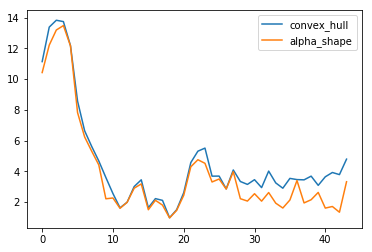

In [260]:
from matplotlib import pyplot as plt
plt.plot(df_volumes)
plt.legend(df_volumes.columns)

In [249]:
volumes[23]

57.66109033988717

In [250]:
df.head()

,Position X,Position Y,Position Z,Time,chromosomes pairs
0,49.987499,8.34553,5.11202,1,1M
1,50.632500,7.74699,5.38543,1,1PB
2,48.267502,6.63995,4.52075,1,2M
3,48.697498,6.30788,5.34636,1,2PB
4,52.631500,8.60928,6.09266,1,3M


# Testing full df

## Load data

In [2]:
# input_file = "/Users/audi/Downloads/JDU233_31Z_30X_10s_04 congression measure.xlsx"
input_file = "/Users/audi/Downloads/191017_14 pm congression measure.xlsx"
sheet_name = "position chromosome"
df = pd.read_excel(input_file, sheet_name=sheet_name, header=1)
df = df[["Position X", "Position Y", "Position Z", "Time", "chromosomes pairs"]]
df = df.dropna()

In [3]:
df[df.Time==24]

,Position X,Position Y,Position Z,Time,chromosomes pairs
276,43.040199,12.41960,5.37830,24,1M
277,43.025799,11.95920,5.92787,24,1PB
278,42.032501,10.90360,4.36052,24,2M
279,42.247501,10.30180,5.19832,24,2PB
280,40.742500,13.15540,5.70734,24,3M
281,40.957500,12.77780,6.51294,24,3PB
282,39.028999,10.20310,7.35000,24,4M
283,39.773201,10.57790,7.05000,24,4PB
284,40.375599,10.29260,3.75000,24,5M
285,40.488998,9.61438,4.35000,24,5PB


In [4]:
df.head()

,Position X,Position Y,Position Z,Time,chromosomes pairs
0,49.987499,8.34553,5.11202,1,1M
1,50.632500,7.74699,5.38543,1,1PB
2,48.267502,6.63995,4.52075,1,2M
3,48.697498,6.30788,5.34636,1,2PB
4,52.631500,8.60928,6.09266,1,3M


In [5]:
df.tail()

,Position X,Position Y,Position Z,Time,chromosomes pairs
523,45.090000,9.56750,5.37034,44,4PB
524,42.481998,11.67860,6.08390,44,5M
525,44.062599,8.92250,4.26712,44,5PB
526,43.484299,12.31190,5.25000,44,6M
527,44.827499,9.59684,4.36643,44,6PB


## Compute volumes

In [37]:
x = df.iloc[:, 0]
y = df.iloc[:, 1]
z = df.iloc[:, 2]
times = df.iloc[:, 3]
names = df.iloc[:, 4]
uniq_times = times.unique()

volumes_as = []
volumes_ch = []
triangles_list = []
pos_list = []
edges_list = []
for time in uniq_times:
    pos = np.array(
        [
            np.array(x[times == time]),
            np.array(y[times == time]),
            np.array(z[times == time]),
        ]
    ).transpose()
    vertices, edges, triangles = alpha_shape_3d_autoalpha(pos)
    triangles = orient_faces(triangles)
    volume_as = compute_volume(pos, triangles)
    volumes_as.append(volume_as)
    volumes_ch.append(compute_convexhull_volume(pos))
    triangles_list.append(triangles)
    pos_list.append(pos)
    edges_list.append(edges)

In [9]:
df_vol = pd.DataFrame({"convex hull": volumes_ch, "alpha shape": volumes_as})

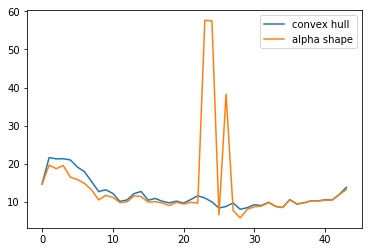

In [12]:
from matplotlib import pyplot as plt
plt.plot(df_vol)
plt.legend(df_vol.columns)
plt.show()

## Check triangles face

In [13]:
volumes_as[24]

57.505736368329785

In [30]:
oriented_triangles = orient_faces(np.array(triangles_list[24]))

In [31]:
list(enumerate(oriented_triangles))

[(0, array([0, 4, 5])),
 (1, [5, 1, 0]),
 (2, [6, 5, 4]),
 (3, [4, 0, 10]),
 (4, [3, 0, 1]),
 (5, [1, 5, 7]),
 (6, [5, 6, 7]),
 (7, [4, 7, 6]),
 (8, [10, 7, 4]),
 (9, [2, 10, 0]),
 (10, [1, 11, 3]),
 (11, [0, 3, 2]),
 (12, [7, 11, 1]),
 (13, [10, 7, 6]),
 (14, [9, 7, 6]),
 (15, [10, 2, 8]),
 (16, [7, 3, 11]),
 (17, [9, 2, 3]),
 (18, [6, 8, 10]),
 (19, [7, 9, 3]),
 (20, [6, 8, 9]),
 (21, [9, 8, 2])]

In [19]:
plot_alphashape(pos_list[24], triangles_list[24])

In [20]:
compute_volume(pos_list[24], triangles_list[24])

57.505736368329785

In [21]:
new_triangles = triangles_list[24]

In [24]:
new_triangles[13] = [10,6,7]
new_triangles[18] = [6,10,8]

In [33]:
compute_volume(pos_list[24], np.array(new_triangles), re_orient=False)

8.510013042915016

In [34]:
def orient_faces(triangles, edge_dict, verbose=False):
    # -- prepare queues     
    next_tri = Queue()
    remaining_tri = Queue()
    for tri in triangles:
        remaining_tri.put(tri)
    # -- process triangles
    res = []
    while not remaining_tri.empty() or not next_tri.empty():
        if next_tri.empty():
            next_tri.put(remaining_tri.get())
        new_remain = Queue()
        cur_tri = next_tri.get()
        res.append(cur_tri)
        while not remaining_tri.empty():
            tri = remaining_tri.get()
            same_elmts = list(set(cur_tri)&set(tri))
            if len(same_elmts) < 2:
                new_remain.put(tri)
            else:
                new_tri = switch(cur_tri, tri, same_elmts)
                next_tri.put(new_tri)
                if verbose:
                    print(f"{cur_tri} vs {tri} --> {new_tri}")
        remaining_tri = new_remain
    return res

In [36]:
res = orient_faces(np.array(new_triangles), verbose=True)

[0 4 5] vs [5 1 0] --> [5, 1, 0]
[0 4 5] vs [6 5 4] --> [6, 5, 4]
[0 4 5] vs [ 4  0 10] --> [4, 0, 10]
[5, 1, 0] vs [3 0 1] --> [3, 0, 1]
[5, 1, 0] vs [1 5 7] --> [1, 5, 7]
[6, 5, 4] vs [5 6 7] --> [5, 6, 7]
[6, 5, 4] vs [4 7 6] --> [4, 7, 6]
[4, 0, 10] vs [10  7  4] --> [10, 7, 4]
[4, 0, 10] vs [ 2 10  0] --> [2, 10, 0]
[3, 0, 1] vs [ 1 11  3] --> [1, 11, 3]
[3, 0, 1] vs [0 3 2] --> [0, 3, 2]
[1, 5, 7] vs [ 7 11  1] --> [7, 11, 1]
[5, 6, 7] vs [10  6  7] --> [10, 7, 6]
[5, 6, 7] vs [9 7 6] --> [9, 7, 6]
[2, 10, 0] vs [10  2  8] --> [10, 2, 8]
[1, 11, 3] vs [ 7  3 11] --> [7, 3, 11]
[0, 3, 2] vs [9 2 3] --> [9, 2, 3]
[10, 7, 6] vs [ 6 10  8] --> [6, 8, 10]
[9, 7, 6] vs [7 9 3] --> [7, 9, 3]
[9, 7, 6] vs [6 8 9] --> [6, 8, 9]
[10, 2, 8] vs [9 8 2] --> [9, 8, 2]


In [40]:
edges_list[24]

array([[ 0,  1],
       [ 0,  2],
       [ 0,  3],
       [ 0,  4],
       [ 0,  5],
       [ 0, 10],
       [ 1,  3],
       [ 1,  5],
       [ 1,  7],
       [ 1, 11],
       [ 2,  3],
       [ 2,  8],
       [ 2,  9],
       [ 2, 10],
       [ 3,  7],
       [ 3,  9],
       [ 3, 11],
       [ 4,  5],
       [ 4,  6],
       [ 4,  7],
       [ 4, 10],
       [ 5,  6],
       [ 5,  7],
       [ 6,  7],
       [ 6,  8],
       [ 6,  9],
       [ 6, 10],
       [ 7,  9],
       [ 7, 10],
       [ 7, 11],
       [ 8,  9],
       [ 8, 10]], dtype=int32)

In [42]:
from collections import defaultdict
edge_dict = defaultdict(list)
for [k,v] in edges_list[24]:
    edge_dict[k].append(v)

In [43]:
edge_dict

defaultdict(list,
            {0: [1, 2, 3, 4, 5, 10],
             1: [3, 5, 7, 11],
             2: [3, 8, 9, 10],
             3: [7, 9, 11],
             4: [5, 6, 7, 10],
             5: [6, 7],
             6: [7, 8, 9, 10],
             7: [9, 10, 11],
             8: [9, 10]})

In [47]:
def alpha_shape_3d_autoalpha(pos):
    """
    Based on: https://stackoverflow.com/questions/26303878/alpha-shapes-in-3d
    Compute the alpha shape (concave hull) of a set of 3D points.
    Alpha value is computed automatically to include all points as vertices.
    Parameters:
        pos - np.array of shape (n,3) points.
    return
        outer surface vertex indices, edge indices, and triangle indices
    """

    tetra = Delaunay(pos)
    # Find radius of the circumsphere.
    # By definition, radius of the sphere fitting inside the tetrahedral needs
    # to be smaller than alpha value
    # http://mathworld.wolfram.com/Circumsphere.html
    tetrapos = np.take(pos, tetra.vertices, axis=0)
    normsq = np.sum(tetrapos ** 2, axis=2)[:, :, None]
    ones = np.ones((tetrapos.shape[0], tetrapos.shape[1], 1))
    a = np.linalg.det(np.concatenate((tetrapos, ones), axis=2))
    Dx = np.linalg.det(np.concatenate((normsq, tetrapos[:, :, [1, 2]], ones), axis=2))
    Dy = -np.linalg.det(np.concatenate((normsq, tetrapos[:, :, [0, 2]], ones), axis=2))
    Dz = np.linalg.det(np.concatenate((normsq, tetrapos[:, :, [0, 1]], ones), axis=2))
    c = np.linalg.det(np.concatenate((normsq, tetrapos), axis=2))
    r = np.sqrt(Dx ** 2 + Dy ** 2 + Dz ** 2 - 4 * a * c) / (2 * np.abs(a))

#     print(r)
    sorted_r = sorted(list(set(r)))[::-1]
#     print(sorted_r)

    for i in range(len(sorted_r)):
        if i == len(sorted_r) - 1:
            diff = 0.1
        else:
            diff = (sorted_r[i + 1] - sorted_r[i]) / 2
        alpha = sorted_r[i] + diff
        # Find tetrahedrals
        tetras = tetra.vertices[r < alpha, :]
        # triangles
        TriComb = np.array([(0, 1, 2), (0, 1, 3), (0, 2, 3), (1, 2, 3)])
        Triangles = tetras[:, TriComb].reshape(-1, 3)
        Triangles = np.sort(Triangles, axis=1)
        # Remove triangles that occurs twice, because they are within shapes
        TrianglesDict = defaultdict(int)
        for tri in Triangles:
            TrianglesDict[tuple(tri)] += 1
        Triangles = np.array([tri for tri in TrianglesDict if TrianglesDict[tri] == 1])
        # edges
        EdgeComb = np.array([(0, 1), (0, 2), (1, 2)])
        Edges = Triangles[:, EdgeComb].reshape(-1, 2)
        Edges = np.sort(Edges, axis=1)
        Edges = np.unique(Edges, axis=0)
        Vertices = np.unique(Edges)
        if len(Vertices) == len(pos):
            break

    return Vertices, Edges, Triangles, tetras

In [48]:
v, e, t, tetras = alpha_shape_3d_autoalpha(pos_list[24])

In [49]:
plot_alphashape(pos_list[24], t)

In [50]:
tetras

array([[11,  5,  4,  1],
       [ 0, 11,  4,  1],
       [ 0,  5,  4,  1],
       [ 3,  0, 11,  1],
       [ 7, 11,  5,  1],
       [ 7,  5,  4,  6],
       [ 7, 11,  5,  4],
       [10,  0, 11,  4],
       [10,  7, 11,  4],
       [10,  3,  0, 11],
       [10,  7,  8,  6],
       [ 9,  7,  3, 11],
       [ 9, 10,  7,  8],
       [ 9, 10,  7, 11],
       [ 9,  7,  8,  6],
       [ 2, 10,  3, 11],
       [ 2,  9,  3, 11],
       [ 2,  9, 10, 11],
       [ 2,  9, 10,  8],
       [ 2, 10,  3,  0]], dtype=int32)

In [51]:
def plot_tetras(pts, tetras, text=None):
    if text is None:
        text = [str(i) for i in range(len(pts))]
    fig = make_subplots()
    for s in tetras:
        vtx = np.array([pts[i] for i in s])
        trace = go.Mesh3d(
            x=vtx[:, 0],
            y=vtx[:, 1],
            z=vtx[:, 2],
            i=[0, 0, 0, 1],
            j=[1, 2, 3, 2],
            k=[2, 3, 1, 3],
            name="y",
#             opacity=0.7
        )
        fig.add_trace(trace)
    fig.add_trace(
        go.Scatter3d(
            x=pts[:, 0], y=pts[:, 1], z=pts[:, 2], mode="markers+text", text=text
        )
    )
    return fig


In [57]:
plot_tetras(pos_list[24], tetras[:2])

# Try using tetras

In [92]:
v, e, t, tetras = alpha_shape_3d_autoalpha(pos_list[24])

In [93]:
list(enumerate(t))

[(0, array([0, 4, 5], dtype=int32)),
 (1, array([0, 1, 5], dtype=int32)),
 (2, array([0, 1, 3], dtype=int32)),
 (3, array([ 1,  3, 11], dtype=int32)),
 (4, array([ 1,  7, 11], dtype=int32)),
 (5, array([1, 5, 7], dtype=int32)),
 (6, array([5, 6, 7], dtype=int32)),
 (7, array([4, 6, 7], dtype=int32)),
 (8, array([4, 5, 6], dtype=int32)),
 (9, array([ 0,  4, 10], dtype=int32)),
 (10, array([ 4,  7, 10], dtype=int32)),
 (11, array([ 6,  7, 10], dtype=int32)),
 (12, array([ 6,  8, 10], dtype=int32)),
 (13, array([3, 7, 9], dtype=int32)),
 (14, array([ 3,  7, 11], dtype=int32)),
 (15, array([6, 7, 9], dtype=int32)),
 (16, array([6, 8, 9], dtype=int32)),
 (17, array([2, 3, 9], dtype=int32)),
 (18, array([2, 8, 9], dtype=int32)),
 (19, array([ 2,  8, 10], dtype=int32)),
 (20, array([ 0,  2, 10], dtype=int32)),
 (21, array([0, 2, 3], dtype=int32))]

In [94]:
tetras

array([[11,  5,  4,  1],
       [ 0, 11,  4,  1],
       [ 0,  5,  4,  1],
       [ 3,  0, 11,  1],
       [ 7, 11,  5,  1],
       [ 7,  5,  4,  6],
       [ 7, 11,  5,  4],
       [10,  0, 11,  4],
       [10,  7, 11,  4],
       [10,  3,  0, 11],
       [10,  7,  8,  6],
       [ 9,  7,  3, 11],
       [ 9, 10,  7,  8],
       [ 9, 10,  7, 11],
       [ 9,  7,  8,  6],
       [ 2, 10,  3, 11],
       [ 2,  9,  3, 11],
       [ 2,  9, 10, 11],
       [ 2,  9, 10,  8],
       [ 2, 10,  3,  0]], dtype=int32)

In [97]:
vol_sum = 0
for plane in t:
    plane_coords = pos_list[24][plane]
    plane, plane_coords
    for tetra in tetras:
        same_elmts = list(set(plane)&set(tetra))
        if len(same_elmts) == 3:
            break
#             print(tetra)
    idx_other = np.where((tetra != same_elmts[0]) & (tetra != same_elmts[1]) & (tetra != same_elmts[2]))[0][0]
    idx_other = tetra[idx_other]
#             print(idx_other)
    A, B, C = plane_coords
    X = pos_list[24][idx_other]
#     print(A, B, C, X)
    Bp = B - A
    Cp = C - A
    Xp = X - A
    plane_sign = np.linalg.det(np.array([Bp, Cp, Xp]))
    plane_vol = np.linalg.det(plane_coords)/6
    if plane_sign > 0:
        sign = 1
    else:
        sign = -1
    print(plane, sign, plane_vol)
    vol_sum += sign*plane_vol
vol_sum

[0 4 5] -1 10.466521531694513
[0 1 5] 1 -13.860681256338088
[0 1 3] -1 9.893197273139942
[ 1  3 11] 1 1.0428820816145905
[ 1  7 11] -1 2.4338798797234547
[1 5 7] -1 12.285904449589792
[5 6 7] -1 4.085622301931179
[4 6 7] 1 5.4728584633998585
[4 5 6] 1 9.485993831005219
[ 0  4 10] 1 0.13260696964517862
[ 4  7 10] 1 23.565019962935878
[ 6  7 10] -1 2.1069665520734913
[ 6  8 10] 1 26.604828214780884
[3 7 9] -1 0.15096225531212473
[ 3  7 11] 1 -8.813793413220488
[6 7 9] 1 -2.879929708151994
[6 8 9] -1 -15.430598837604295
[2 3 9] -1 4.12539153782162
[2 8 9] 1 -3.5387581980085727
[ 2  8 10] -1 -0.15486340152560998
[ 0  2 10] -1 0.19981135411568932
[0 2 3] 1 -15.558245094305583


-8.510013042915016

In [91]:
volumes_ch[24]

9.99302793026101

## Try on ~correct size

In [103]:
vol_tetras = []
for i in range(len(pos_list)):
    v, e, t, tetras = alpha_shape_3d_autoalpha(pos_list[i])
    vol_sum = 0
    for plane in t:
        plane_coords = pos_list[i][plane]
        plane, plane_coords
        for tetra in tetras:
            same_elmts = list(set(plane)&set(tetra))
            if len(same_elmts) == 3:
                break
        idx_other = np.where((tetra != same_elmts[0]) & (tetra != same_elmts[1]) & (tetra != same_elmts[2]))[0][0]
        idx_other = tetra[idx_other]
        A, B, C = plane_coords
        X = pos_list[i][idx_other]
        Bp = B - A
        Cp = C - A
        Xp = X - A
        plane_sign = np.linalg.det(np.array([Bp, Cp, Xp]))
        plane_vol = np.linalg.det(plane_coords)/6
        if plane_sign > 0:
            sign = 1
        else:
            sign = -1
        vol_sum += sign*plane_vol
    vol_tetras.append(abs(vol_sum))

In [104]:
df_vols = pd.DataFrame({
    "Conv hull": volumes_ch,
    "Alpha space": volumes_as,
    "Alpha with Tetras": vol_tetras
})

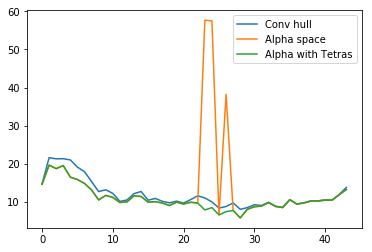

In [106]:
plt.plot(df_vols)
plt.legend(df_vols.columns)
plt.show()

# Ellipsoid

In [6]:
df_111

,Position X,Position Y,Position Z,Time,chromosomes pairs,X,Y,Z,X.1,Y.1,Z.1
276,43.040199,12.41960,5.37830,24,1M,-0.014400,-0.460400,0.54957,43.032999,12.18940,5.653085
277,43.025799,11.95920,5.92787,24,1PB,NaN,NaN,NaN,NaN,NaN,NaN
278,42.032501,10.90360,4.36052,24,2M,0.215000,-0.601800,0.83780,42.140001,10.60270,4.779420
279,42.247501,10.30180,5.19832,24,2PB,NaN,NaN,NaN,NaN,NaN,NaN
280,40.742500,13.15540,5.70734,24,3M,0.215000,-0.377601,0.80560,40.850000,12.96660,6.110140
281,40.957500,12.77780,6.51294,24,3PB,NaN,NaN,NaN,NaN,NaN,NaN
282,39.028999,10.20310,7.35000,24,4M,0.744202,0.374800,-0.30000,39.401100,10.39050,7.200000
283,39.773201,10.57790,7.05000,24,4PB,NaN,NaN,NaN,NaN,NaN,NaN
284,40.375599,10.29260,3.75000,24,5M,0.113400,-0.678220,0.60000,40.432299,9.95349,4.050000
285,40.488998,9.61438,4.35000,24,5PB,NaN,NaN,NaN,NaN,NaN,NaN


## First approach
https://jekel.me/2020/Least-Squares-Ellipsoid-Fit/

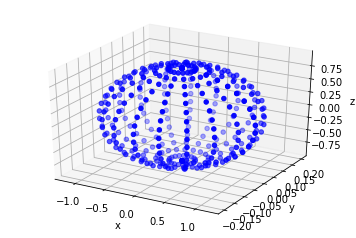

In [34]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

a = 1.2
b = 0.2
c = 0.9

u = np.linspace(0., np.pi*2., 20)
v = np.linspace(0., np.pi, 20)
u, v = np.meshgrid(u,v)

x = a*np.cos(u)*np.sin(v)
y = b*np.sin(u)*np.sin(v)
z = c*np.cos(v)

# turn this data into 1d arrays
x = x.flatten()
y = y.flatten()
z = z.flatten()

#   3D plot of ellipsoid
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x, y, z, zdir='z', s=20, c='b',rasterized=True)
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')
plt.show()

In [35]:
def create_ellips(x, y, z):
    # build our regression matrix
    A = np.array([x**2, y**2, z**2]).T

    # vector of ones
    O = np.ones(len(x))

    # least squares solver
    B, resids, rank, s = np.linalg.lstsq(A, O)
    
    B = abs(B)

    # solving for a, b, c
    a_ls = np.sqrt(1.0/B[0])
    b_ls = np.sqrt(1.0/B[1])
    c_ls = np.sqrt(1.0/B[2])
    
    return a_ls, b_ls, c_ls

In [36]:
a_ls, b_ls, c_ls = create_ellips(x, y, z)

/Users/audi/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: FutureWarning:

`rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.



In [37]:
a_ls, b_ls, c_ls

(1.2000000000000002, 0.2, 0.9000000000000006)

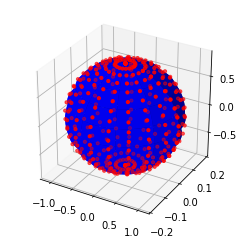

In [38]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np

fig = plt.figure(figsize=plt.figaspect(1))  # Square figure
ax = fig.add_subplot(111, projection='3d')

# coefs = (a_ls, b_ls, c_ls)  # Coefficients in a0/c x**2 + a1/c y**2 + a2/c z**2 = 1 
# Radii corresponding to the coefficients:
# rx, ry, rz = 1/np.sqrt(coefs)
rx = a_ls
ry = b_ls
rz = c_ls

# Set of all spherical angles:
u = np.linspace(0, 2 * np.pi, 100)
v = np.linspace(0, np.pi, 100)

# Cartesian coordinates that correspond to the spherical angles:
# (this is the equation of an ellipsoid):
x_el = rx * np.outer(np.cos(u), np.sin(v))
y_el = ry * np.outer(np.sin(u), np.sin(v))
z_el = rz * np.outer(np.ones_like(u), np.cos(v))

# Plot:
ax.plot_surface(x_el, y_el, z_el,  rstride=10, cstride=10, color='b')

ax.scatter(x, y, z, zdir='z', s=10, c='red',rasterized=True)

# Adjustment of the axes, so that they all have the same span:
max_radius = max(rx, ry, rz)
for axis in 'xyz':
    getattr(ax, 'set_{}lim'.format(axis))((-max_radius, max_radius))
    
getattr(ax, 'set_xlim')((-rx, rx))    
getattr(ax, 'set_ylim')((-ry, ry))    
getattr(ax, 'set_zlim')((-rz, rz))    

plt.show()

In [39]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.offline as pyo
pyo.init_notebook_mode()

fig = go.Figure(
        data=[
            go.Surface(x=x_el, y=y_el, z=z_el, opacity=0.9, 
                    showscale=False,
                       colorscale=[[0, '#fcba03'], [1,'#fcba03']]
                      ),
            go.Scatter3d(
                x=x, y=y, z=z, 
                mode='markers',
                marker=dict(
                    size=3,
                    opacity=1,
                    color='red'
                )
            ),
            go.Scatter3d(
                x=x_el.flatten(), y=y_el.flatten(), z=z_el.flatten(), 
                mode='lines',
                marker=dict(
                    size=1,
                    opacity=1,
                    color='blue'
                )
            )
        ]
    )
fig.update_traces(showlegend=False)
fig.show()

### 111

In [40]:
df_111.head()

,Position X,Position Y,Position Z,Time,chromosomes pairs,X,Y,Z,X.1,Y.1,Z.1
276,43.040199,12.4196,5.37830,24,1M,-0.0144,-0.460400,0.54957,43.032999,12.1894,5.653085
277,43.025799,11.9592,5.92787,24,1PB,NaN,NaN,NaN,NaN,NaN,NaN
278,42.032501,10.9036,4.36052,24,2M,0.2150,-0.601800,0.83780,42.140001,10.6027,4.779420
279,42.247501,10.3018,5.19832,24,2PB,NaN,NaN,NaN,NaN,NaN,NaN
280,40.742500,13.1554,5.70734,24,3M,0.2150,-0.377601,0.80560,40.850000,12.9666,6.110140


In [41]:
x = df_111['Position X']
y = df_111['Position Y']
z = df_111['Position Z']

In [42]:
rx, ry, rz = create_ellips(x, y, z)
rx, ry, rz

/Users/audi/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: FutureWarning:

`rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.



(41.42742276811461, 41.20622318608849, 19.58478867228085)

In [43]:
# Set of all spherical angles:
u = np.linspace(0, 2 * np.pi, 100)
v = np.linspace(0, np.pi, 100)

# Cartesian coordinates that correspond to the spherical angles:
# (this is the equation of an ellipsoid):
x_el = rx * np.outer(np.cos(u), np.sin(v))
y_el = ry * np.outer(np.sin(u), np.sin(v))
z_el = rz * np.outer(np.ones_like(u), np.cos(v))

In [44]:
fig = go.Figure(
        data=[
            go.Surface(x=x_el, y=y_el, z=z_el, opacity=0.9, 
                    showscale=False,
                       colorscale=[[0, 'green'], [1,'green']]
                      ),
            go.Scatter3d(
                x=x, y=y, z=z, 
                mode='markers',
                marker=dict(
                    size=3,
                    opacity=1,
                    color='red'
                )
            ),
            go.Scatter3d(
                x=x_el.flatten(), y=y_el.flatten(), z=z_el.flatten(), 
                mode='lines',
                marker=dict(
                    size=1,
                    opacity=0.9,
                    color='blue'
                )
            )
        ]
    )
fig.update_traces(showlegend=False)
fig.show()

In [47]:
fig = go.Figure(
        data=[
            go.Scatter3d(
                x=x, y=y, z=z, 
                mode='markers',
                marker=dict(
                    size=3,
                    opacity=1,
                    color='red'
                )
            ),
            go.Scatter3d(
                x=[x.mean()], y=[y.mean()], z=[z.mean()], 
                mode='markers',
                marker=dict(
                    size=3,
                    opacity=1,
                    color='black'
                )
            ),
            go.Scatter3d(
                x=x-x.mean(), y=y-y.mean(), z=z-z.mean(), 
                mode='markers',
                marker=dict(
                    size=3,
                    opacity=1,
                    color='blue'
                )
            ),
        ]
    )
fig.update_traces(showlegend=False)
fig.show()

In [48]:
x = x-x.mean()
y = y-y.mean()
z = z-z.mean()

In [49]:
rx, ry, rz = create_ellips(x, y, z)
rx, ry, rz

/Users/audi/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: FutureWarning:

`rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.



(2.5963557720300394, 1.8496910781464677, 2.2973638696602556)

In [51]:
# Set of all spherical angles:
u = np.linspace(0, 2 * np.pi, 100)
v = np.linspace(0, np.pi, 100)

# Cartesian coordinates that correspond to the spherical angles:
# (this is the equation of an ellipsoid):
x_el = rx * np.outer(np.cos(u), np.sin(v))
y_el = ry * np.outer(np.sin(u), np.sin(v))
z_el = rz * np.outer(np.ones_like(u), np.cos(v))

In [53]:
fig = go.Figure(
        data=[
#             go.Surface(x=x_el, y=y_el, z=z_el, opacity=0.9, 
#                     showscale=False,
#                        colorscale=[[0, 'green'], [1,'green']]
#                       ),
            go.Scatter3d(
                x=x, y=y, z=z, 
                mode='markers',
                marker=dict(
                    size=3,
                    opacity=1,
                    color='red'
                )
            ),
            go.Scatter3d(
                x=x_el.flatten(), y=y_el.flatten(), z=z_el.flatten(), 
                mode='lines',
                marker=dict(
                    size=1,
                    opacity=0.9,
                    color='blue'
                )
            )
        ]
    )
fig.update_traces(showlegend=False)
fig.show()

## Second approach

In [6]:
from   scipy.spatial import ConvexHull, convex_hull_plot_2d
import numpy as np
from   numpy.linalg import eig, inv

def ls_ellipsoid(xx,yy,zz):                                  
    #finds best fit ellipsoid. Found at http://www.juddzone.com/ALGORITHMS/least_squares_3D_ellipsoid.html
    #least squares fit to a 3D-ellipsoid
    #  Ax^2 + By^2 + Cz^2 +  Dxy +  Exz +  Fyz +  Gx +  Hy +  Iz  = 1
    #
    # Note that sometimes it is expressed as a solution to
    #  Ax^2 + By^2 + Cz^2 + 2Dxy + 2Exz + 2Fyz + 2Gx + 2Hy + 2Iz  = 1
    # where the last six terms have a factor of 2 in them
    # This is in anticipation of forming a matrix with the polynomial coefficients.
    # Those terms with factors of 2 are all off diagonal elements.  These contribute
    # two terms when multiplied out (symmetric) so would need to be divided by two
    
    # change xx from vector of length N to Nx1 matrix so we can use hstack
    x = xx[:,np.newaxis]
    y = yy[:,np.newaxis]
    z = zz[:,np.newaxis]
    
    #  Ax^2 + By^2 + Cz^2 +  Dxy +  Exz +  Fyz +  Gx +  Hy +  Iz = 1
    J = np.hstack((x*x,y*y,z*z,x*y,x*z,y*z, x, y, z))
    K = np.ones_like(x) #column of ones
    
    #np.hstack performs a loop over all samples and creates
    #a row in J for each x,y,z sample:
    # J[ix,0] = x[ix]*x[ix]
    # J[ix,1] = y[ix]*y[ix]
    # etc.
    
    JT=J.transpose()
    JTJ = np.dot(JT,J)
    InvJTJ=np.linalg.inv(JTJ);
    ABC= np.dot(InvJTJ, np.dot(JT,K))

    # Rearrange, move the 1 to the other side
    #  Ax^2 + By^2 + Cz^2 +  Dxy +  Exz +  Fyz +  Gx +  Hy +  Iz - 1 = 0
    #    or
    #  Ax^2 + By^2 + Cz^2 +  Dxy +  Exz +  Fyz +  Gx +  Hy +  Iz + J = 0
    #  where J = -1
    eansa=np.append(ABC,-1)

    return (eansa)

def polyToParams3D(vec,printMe):                             
    #gets 3D parameters of an ellipsoid. Found at http://www.juddzone.com/ALGORITHMS/least_squares_3D_ellipsoid.html
    # convert the polynomial form of the 3D-ellipsoid to parameters
    # center, axes, and transformation matrix
    # vec is the vector whose elements are the polynomial
    # coefficients A..J
    # returns (center, axes, rotation matrix)
    
    #Algebraic form: X.T * Amat * X --> polynomial form
    
    if printMe: print('\npolynomial\n',vec)
    
    Amat=np.array(
    [
    [ vec[0],     vec[3]/2.0, vec[4]/2.0, vec[6]/2.0 ],
    [ vec[3]/2.0, vec[1],     vec[5]/2.0, vec[7]/2.0 ],
    [ vec[4]/2.0, vec[5]/2.0, vec[2],     vec[8]/2.0 ],
    [ vec[6]/2.0, vec[7]/2.0, vec[8]/2.0, vec[9]     ]
    ])
    
    if printMe: print('\nAlgebraic form of polynomial\n',Amat)
    
    #See B.Bartoni, Preprint SMU-HEP-10-14 Multi-dimensional Ellipsoidal Fitting
    # equation 20 for the following method for finding the center
    A3=Amat[0:3,0:3]
    A3inv=inv(A3)
    ofs=vec[6:9]/2.0
    center=-np.dot(A3inv,ofs)
    if printMe: print('\nCenter at:',center)
    
    # Center the ellipsoid at the origin
    Tofs=np.eye(4)
    Tofs[3,0:3]=center
    R = np.dot(Tofs,np.dot(Amat,Tofs.T))
    if printMe: print('\nAlgebraic form translated to center\n',R,'\n')
    
    R3=R[0:3,0:3]
    R3test=R3/R3[0,0]
    # print('normed \n',R3test)
    s1=-R[3, 3]
    R3S=R3/s1
    (el,ec)=eig(R3S)
    
    recip=1.0/np.abs(el)
    axes=np.sqrt(recip)
    if printMe: print('\nAxes are\n',axes  ,'\n')
    
    inve=inv(ec) #inverse is actually the transpose here
    if printMe: print('\nRotation matrix\n',inve)
    return (center,axes,inve)

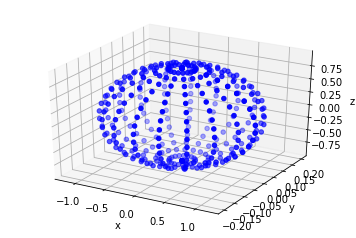

In [7]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

a = 1.2
b = 0.2
c = 0.9

u = np.linspace(0., np.pi*2., 20)
v = np.linspace(0., np.pi, 20)
u, v = np.meshgrid(u,v)

x = a*np.cos(u)*np.sin(v)
y = b*np.sin(u)*np.sin(v)
z = c*np.cos(v)

# turn this data into 1d arrays
x = x.flatten()
y = y.flatten()
z = z.flatten()

#   3D plot of ellipsoid
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x, y, z, zdir='z', s=20, c='b',rasterized=True)
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')
plt.show()

In [8]:
#get convex hull
surface  = np.stack((x, y, z), axis=-1)
hullV    = ConvexHull(surface)
lH       = len(hullV.vertices)
hull     = np.zeros((lH,3))
for i in range(len(hullV.vertices)):
    hull[i] = surface[hullV.vertices[i]]
hull     = np.transpose(hull)         
            
#fit ellipsoid on convex hull
eansa            = ls_ellipsoid(hull[0],hull[1],hull[2]) #get ellipsoid polynomial coefficients
print("coefficients:"  , eansa)
center,axes,inve = polyToParams3D(eansa,False)   #get ellipsoid 3D parameters
print("center:"        , center)
print("axes:"          , axes)
print("rotationMatrix:", inve)

coefficients: [ 6.94444444e-01  2.50000000e+01  1.23456790e+00 -2.39811268e-16
  5.32445810e-20 -1.33956200e-16 -3.08759754e-17 -3.54063364e-17
 -1.08623944e-15 -1.00000000e+00]
center: [2.22307023e-17 7.08126728e-19 4.39926974e-16]
axes: [1.2 0.2 0.9]
rotationMatrix: [[ 1.00000000e+00  4.93326038e-18 -4.92892692e-20]
 [-0.00000000e+00 -1.00000000e+00  2.66461693e-18]
 [ 0.00000000e+00  2.62919027e-18  1.00000000e+00]]


In [9]:
rx, ry, rz =axes

# Set of all spherical angles:
u = np.linspace(0, 2 * np.pi, 100)
v = np.linspace(0, np.pi, 100)

# Cartesian coordinates that correspond to the spherical angles:
# (this is the equation of an ellipsoid):
x_el = rx * np.outer(np.cos(u), np.sin(v))
y_el = ry * np.outer(np.sin(u), np.sin(v))
z_el = rz * np.outer(np.ones_like(u), np.cos(v))

In [10]:
xp, yp, zp = np.array(inve).dot(np.stack([x_el.flatten(), y_el.flatten(), z_el.flatten()]))

In [15]:
fig = go.Figure(
        data=[
#             go.Surface(x=x_el, y=y_el, z=z_el, opacity=0.9, 
#                     showscale=False,
#                        colorscale=[[0, 'green'], [1,'green']]
#                       ),
            go.Scatter3d(
                x=x, y=y, z=z, 
                mode='markers',
                marker=dict(
                    size=3,
                    opacity=1,
                    color='red'
                )
            ),
#             go.Scatter3d(
#                 x=x_el.flatten(), y=y_el.flatten(), z=z_el.flatten(), 
#                 mode='lines',
#                 marker=dict(
#                     size=1,
#                     opacity=0.9,
#                     color='blue'
#                 )
#             ),
            go.Scatter3d(
                x=xp + center[0], y=yp + center[1], z=zp + center[2], 
                mode='lines',
                marker=dict(
                    size=1,
                    opacity=0.9,
                    color='blue'
                )
            ),
            go.Scatter3d(
                x=hullV.points[:,0], y=hullV.points[:,1], z=hullV.points[:,2], 
                mode='markers',
                marker=dict(
                    size=5,
                    opacity=0.9,
                    color='green'
                )
            ),
#             go.Scatter3d(
#                 x=inve[0] + center[0], y=inve[1] + center[1], z=inve[2] + center[2], 
#                 mode='markers',
#                 marker=dict(
#                     size=5,
#                     opacity=1,
#                     color='black'
#                 )
#             ),
            go.Scatter3d(
                x=[center[0]], y=[center[1]], z=[center[2]], 
                mode='markers',
                marker=dict(
                    size=5,
                    opacity=1,
                    color='pink'
                )
            ),
#             go.Mesh3d(
#                 # 8 vertices of a cube
#                 x=[0, 0, 1, 1, 0, 0, 1, 1],
#                 y=[0, 1, 1, 0, 0, 1, 1, 0],
#                 z=[0, 0, 0, 0, 1, 1, 1, 1],
#             )
        ]
    )

for tri in hullV.points[hullV.simplices]:
    fig.add_trace(
        go.Mesh3d(
            x = tri[:,0],
            y = tri[:,1],
            z = tri[:,2]
        )
    )

fig.update_traces(showlegend=False)
fig.show()

### Random ellipsoid

In [198]:
import numpy as np
from pyellipsoid import drawing, analysis

# Draw a 3D binary image containing an ellipsoid
image_shape = (128, 128, 128)
ell_center = (64, 64, 64)
ell_radii = (10, 5, 20)
ell_angles = np.deg2rad([80, 30, 20])
image = drawing.make_ellipsoid_image(image_shape, ell_center, ell_radii, ell_angles)

# Compute inertia ellipsoid
points = analysis.sample_random_points(image, n=100)
inertia_ellipsoid = analysis.compute_inertia_ellipsoid(points)

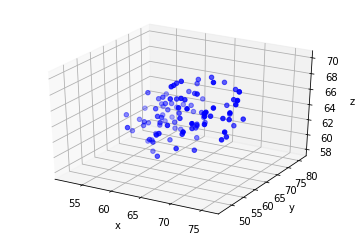

In [267]:
x = points[:, 0]
y = points[:, 1]
z = points[:, 2]
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x, y, z, zdir='z', s=20, c='b',rasterized=True)
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')
plt.show()

In [268]:
#get convex hull
surface  = np.stack((x, y, z), axis=-1)
hullV    = ConvexHull(surface)
lH       = len(hullV.vertices)
hull     = np.zeros((lH,3))
for i in range(len(hullV.vertices)):
    hull[i] = surface[hullV.vertices[i]]
hull     = np.transpose(hull)         
            
#fit ellipsoid on convex hull
eansa            = ls_ellipsoid(hull[0],hull[1],hull[2]) #get ellipsoid polynomial coefficients
print("coefficients:"  , eansa)
center,axes,inve = polyToParams3D(eansa,False)   #get ellipsoid 3D parameters
print("center:"        , center)
print("axes:"          , axes)
print("rotationMatrix:", inve)

coefficients: [-5.87015625e-05 -2.58638629e-05 -2.24734119e-04 -3.23048547e-05
  1.14615487e-04 -1.78759956e-05  2.27200915e-03  6.54189156e-03
  2.25577119e-02 -1.00000000e+00]
center: [64.1140893  64.31774305 63.9787938 ]
axes: [ 4.45745429  9.54672805 18.73151904]
rotationMatrix: [[-0.29599901  0.01732042  0.9550312 ]
 [-0.79747157 -0.55481625 -0.2371034 ]
 [-0.5257601   0.8317926  -0.1780376 ]]


In [269]:
rx, ry, rz =axes

# Set of all spherical angles:
u = np.linspace(0, 2 * np.pi, 100)
v = np.linspace(0, np.pi, 100)

# Cartesian coordinates that correspond to the spherical angles:
# (this is the equation of an ellipsoid):
x_el = rx * np.outer(np.cos(u), np.sin(v))
y_el = ry * np.outer(np.sin(u), np.sin(v))x
z_el = rz * np.outer(np.ones_like(u), np.cos(v))

In [272]:
radii = axes
rotation = inve

# now carry on with EOL's answer
u = np.linspace(0.0, 2.0 * np.pi, 100)
v = np.linspace(0.0, np.pi, 100)
x2 = radii[0] * np.outer(np.cos(u), np.sin(v))
y2 = radii[1] * np.outer(np.sin(u), np.sin(v))
z2 = radii[2] * np.outer(np.ones_like(u), np.cos(v))
for i in range(len(x)):
    for j in range(len(x)):
        [x2[i,j],y2[i,j],z2[i,j]] = np.dot([x2[i,j],y2[i,j],z2[i,j]], rotation) + center

In [270]:
xp, yp, zp = np.array(inve).dot(np.stack([x_el.flatten(), y_el.flatten(), z_el.flatten()]))

In [271]:
xxx = np.stack([x_el.flatten(), y_el.flatten(), z_el.flatten()]).transpose().dot(np.array(inve))
xp2 = xxx[:,0]
yp2 = xxx[:,1]
zp2 = xxx[:,2]

In [281]:
fig = go.Figure(
        data=[
                go.Surface(x=x2, y=y2, z=z2, 
                       opacity=0.5, 
                        showscale=False,
                       colorscale=[[0, 'green'], [1,'green']]
                      ),
            go.Scatter3d(
                x=x, y=y, z=z, 
                mode='markers+text',
                marker=dict(
                    size=3,
                    opacity=1,
                    color='red'
                ),
                text = list(range(len(x)))
            ),
            go.Scatter3d(
                x=x2.flatten(), y=y2.flatten(), z=z2.flatten(), 
                mode='lines',
                marker=dict(
                    size=1,
                    opacity=0.9,
                    color='yellow'
                )
            )
        ]
    )

# for tri in hullV.points[hullV.simplices]:
#     fig.add_trace(
#         go.Mesh3d(
#             x = tri[:,0],
#             y = tri[:,1],
#             z = tri[:,2]
#         )
#     )

fig.update_traces(showlegend=False)
fig.show()

In [278]:
def in_ellips(eansa, xyz, center):
    A, B, C, D, E, F, G, H, I, J = eansa
    x, y, z = xyz
    val = A*(x*x) + B*(y*y) + C*(z*z) + D*(x*y) + E*(x*z) + F*(y*z) + G*x + H*y + I*z
    if val < 0:
        print(x,y,z)
    return val

In [279]:
vals = []
for i, xyz in enumerate(zip(x, y, z)):
    val = in_ellips(eansa, xyz, center)
    print(i, xyz, val)
    vals.append(val)

0 (75, 58, 68) 1.0008918524250001
1 (68, 58, 64) 1.0037074374281048
2 (65, 58, 69) 0.9993345691621216
3 (56, 67, 61) 1.002392527560094
4 (56, 69, 65) 1.0003472704413852
5 (60, 65, 63) 1.004164588933863
6 (63, 64, 68) 1.0006098316641383
7 (61, 66, 60) 1.002330178219606
8 (63, 65, 64) 1.0047579349669062
9 (66, 58, 65) 1.0040668435235687
10 (65, 61, 69) 0.9997270670070051
11 (58, 56, 63) 0.9995197654708452
12 (66, 65, 63) 1.0041440234862462
13 (76, 53, 68) 1.000218766647822
14 (54, 70, 61) 1.001599547425489
15 (71, 59, 70) 0.999666287758052
16 (59, 68, 65) 1.0026435577553787
17 (56, 81, 61) 0.9997959790279392
18 (65, 51, 64) 1.000576245997851
19 (68, 59, 61) 1.0002671141500328
20 (58, 74, 63) 1.0027547269026678
21 (61, 68, 62) 1.0042283869803414
22 (58, 66, 58) 0.9992222454093911
23 (54, 80, 61) 0.9998736897384575
24 (76, 56, 69) 0.999853606958931
25 (56, 76, 60) 1.001462416573684
26 (61, 75, 63) 1.00269633803423
27 (56, 69, 61) 1.0026423247654905
28 (74, 58, 66) 1.0016700481376182
29 (56

In [238]:
max(vals)

1.0047579349669062

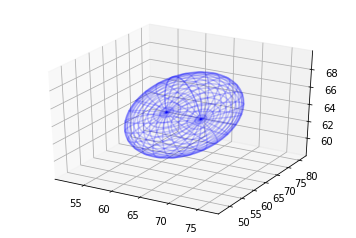

In [257]:
import numpy as np
import numpy.linalg as linalg
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# your ellispsoid and center in matrix form
# A = np.array([[1,0,0],[0,2,0],[0,0,2]])
# center = [0,0,0]

# find the rotation matrix and radii of the axes
# U, s, rotation = linalg.svd(A)
# radii = 1.0/np.sqrt(s)
radii = axes
rotation = inve

# now carry on with EOL's answer
u = np.linspace(0.0, 2.0 * np.pi, 100)
v = np.linspace(0.0, np.pi, 100)
x = radii[0] * np.outer(np.cos(u), np.sin(v))
y = radii[1] * np.outer(np.sin(u), np.sin(v))
z = radii[2] * np.outer(np.ones_like(u), np.cos(v))
for i in range(len(x)):
    for j in range(len(x)):
        [x[i,j],y[i,j],z[i,j]] = np.dot([x[i,j],y[i,j],z[i,j]], rotation) + center

# plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_wireframe(x, y, z,  rstride=4, cstride=4, color='b', alpha=0.2)
plt.show()

### 111

In [282]:
x = df_111['Position X']
y = df_111['Position Y']
z = df_111['Position Z']

In [283]:
#get convex hull
surface  = np.stack((x, y, z), axis=-1)
hullV    = ConvexHull(surface)
lH       = len(hullV.vertices)
hull     = np.zeros((lH,3))
for i in range(len(hullV.vertices)):
    hull[i] = surface[hullV.vertices[i]]
hull     = np.transpose(hull)         
            
#fit ellipsoid on convex hull
eansa            = ls_ellipsoid(hull[0],hull[1],hull[2]) #get ellipsoid polynomial coefficients
print("coefficients:"  , eansa)
center,axes,inve = polyToParams3D(eansa,False)   #get ellipsoid 3D parameters
print("center:"        , center)
print("axes:"          , axes)
print("rotationMatrix:", inve)

coefficients: [-7.23079976e-04 -2.20602615e-05  1.54444871e-04  4.43715414e-04
  3.43437998e-04 -7.93131303e-04  5.29378951e-02 -1.35894418e-02
 -6.50343861e-03 -1.00000000e+00]
center: [41.55767867 11.91888333  5.45240547]
axes: [1.20870172 2.57515398 1.6413261 ]
rotationMatrix: [[ 0.88426094 -0.36629948 -0.28966754]
 [-0.46697244 -0.68772374 -0.55585322]
 [-0.0043975  -0.62678605  0.779179  ]]


In [289]:
rx, ry, rz =axes

# Set of all spherical angles:
u = np.linspace(0, 2 * np.pi, 100)
v = np.linspace(0, np.pi, 100)

# Cartesian coordinates that correspond to the spherical angles:
# (this is the equation of an ellipsoid):
x_el = rx * np.outer(np.cos(u), np.sin(v))
y_el = ry * np.outer(np.sin(u), np.sin(v))
z_el = rz * np.outer(np.ones_like(u), np.cos(v))

In [290]:
xxx = np.stack([x_el.flatten(), y_el.flatten(), z_el.flatten()]).transpose().dot(np.array(inve))
xp2 = xxx[:,0]
yp2 = xxx[:,1]
zp2 = xxx[:,2]

In [321]:
radii = axes
rotation = inve

# now carry on with EOL's answer
u = np.linspace(0.0, 2.0 * np.pi, 100)
v = np.linspace(0.0, np.pi, 100)
x2 = radii[0] * np.outer(np.cos(u), np.sin(v))
y2 = radii[1] * np.outer(np.sin(u), np.sin(v))
z2 = radii[2] * np.outer(np.ones_like(u), np.cos(v))
for i in range(len(x2)):
    for j in range(len(x2)):
#         print(np.dot([x2[i,j],y2[i,j],z2[i,j]], rotation), center)
        [x2[i,j],y2[i,j],z2[i,j]] = np.dot([x2[i,j],y2[i,j],z2[i,j]], rotation) + center
#         print([x2[i,j],y2[i,j],z2[i,j]])
#         print(i, j, y2[i,j])

In [322]:
xxx = np.stack([x_el.flatten(), y_el.flatten(), z_el.flatten()]).transpose().dot(np.array(inve))
xp = xxx[:,0] + center[0]
yp = xxx[:,1] + center[1]
zp = xxx[:,2] + center[2]

In [324]:
fig = go.Figure(
        data=[
            go.Surface(x=x2, y=y2, z=z2, 
                   opacity=0.5, 
                    showscale=False,
                   colorscale=[[0, 'green'], [1,'green']]
                  ),
            go.Scatter3d(
                x=x, y=y, z=z, 
                mode='markers+text',
                marker=dict(
                    size=3,
                    opacity=1,
                    color='red'
                ),
                text = list(range(len(x)))
            ),
            go.Scatter3d(
                x=x2.flatten(), y=y2.flatten(), z=z2.flatten(), 
                mode='lines',
                marker=dict(
                    size=1,
                    opacity=0.9,
                    color='yellow'
                )
            ),
#             go.Scatter3d(
#                 x=xp, y=yp, z=zp, 
#                 mode='lines',
#                 marker=dict(
#                     size=1,
#                     opacity=0.9,
#                     color='yellow'
#                 )
#             )
        ]
    )

# for tri in hullV.points[hullV.simplices]:
#     fig.add_trace(
#         go.Mesh3d(
#             x = tri[:,0],
#             y = tri[:,1],
#             z = tri[:,2]
#         )
#     )

fig.update_traces(showlegend=False)
fig.show()

In [325]:
vals = []
for i, xyz in enumerate(zip(x, y, z)):
    val = in_ellips(eansa, xyz, center)
    print(i, xyz, val)
    vals.append(val)

0 (43.040199279785156, 12.419599533081055, 5.378300189971924) 1.0000000013563146
1 (43.02579879760742, 11.959199905395508, 5.92786979675293) 1.000000001435076
2 (42.032501220703125, 10.903599739074707, 4.360519886016846) 1.0000000015098205
3 (42.247501373291016, 10.301799774169922, 5.198319911956787) 1.0000000016312274
4 (40.74250030517578, 13.155400276184082, 5.707339763641357) 1.0000000009108951
5 (40.95750045776367, 12.777799606323242, 6.512939929962158) 1.000000001006234
6 (39.02899932861328, 10.203100204467773, 7.349999904632568) 1.0000000012104955
7 (39.77320098876953, 10.577899932861328, 7.050000190734863) 1.0011066699851368
8 (40.3755989074707, 10.29259967803955, 3.75) 1.00000000141925
9 (40.48899841308594, 9.6143798828125, 4.349999904632568) 1.0000000015320942
10 (41.068599700927734, 11.525500297546387, 5.25) 1.0011590085900215
11 (41.25450134277344, 10.849699974060059, 6.150000095367432) 1.001919075160514


## Third Approach
https://github.com/minillinim/ellipsoid/blob/master/ellipsoid.py

In [26]:
#!/usr/bin/python

from __future__ import division
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import sys
import numpy as np
from numpy import linalg
from random import random

class EllipsoidTool:
    """Some stuff for playing with ellipsoids"""
    def __init__(self): pass
    
    def getMinVolEllipse(self, P=None, tolerance=0.01):
        """ Find the minimum volume ellipsoid which holds all the points
        
        Based on work by Nima Moshtagh
        http://www.mathworks.com/matlabcentral/fileexchange/9542
        and also by looking at:
        http://cctbx.sourceforge.net/current/python/scitbx.math.minimum_covering_ellipsoid.html
        Which is based on the first reference anyway!
        
        Here, P is a numpy array of N dimensional points like this:
        P = [[x,y,z,...], <-- one point per line
             [x,y,z,...],
             [x,y,z,...]]
        
        Returns:
        (center, radii, rotation)
        
        """
        (N, d) = np.shape(P)
        d = float(d)
    
        # Q will be our working array
        Q = np.vstack([np.copy(P.T), np.ones(N)]) 
        QT = Q.T
        
        # initializations
        err = 1.0 + tolerance
        u = (1.0 / N) * np.ones(N)

        # Khachiyan Algorithm
        while err > tolerance:
            V = np.dot(Q, np.dot(np.diag(u), QT))
            M = np.diag(np.dot(QT , np.dot(linalg.inv(V), Q)))    # M the diagonal vector of an NxN matrix
            j = np.argmax(M)
            maximum = M[j]
            step_size = (maximum - d - 1.0) / ((d + 1.0) * (maximum - 1.0))
            new_u = (1.0 - step_size) * u
            new_u[j] += step_size
            err = np.linalg.norm(new_u - u)
            u = new_u

        # center of the ellipse 
        center = np.dot(P.T, u)
    
        # the A matrix for the ellipse
        A = linalg.inv(
                       np.dot(P.T, np.dot(np.diag(u), P)) - 
                       np.array([[a * b for b in center] for a in center])
                       ) / d
                       
        # Get the values we'd like to return
        U, s, rotation = linalg.svd(A)
        radii = 1.0/np.sqrt(s)
        
        return (center, radii, rotation)

    def getEllipsoidVolume(self, radii):
        """Calculate the volume of the blob"""
        return 4./3.*np.pi*radii[0]*radii[1]*radii[2]

    def plotEllipsoid(self, center, radii, rotation, ax=None, plotAxes=False, cageColor='b', cageAlpha=0.2):
        """Plot an ellipsoid"""
        make_ax = ax == None
        if make_ax:
            fig = plt.figure()
            ax = fig.add_subplot(111, projection='3d')
            
        u = np.linspace(0.0, 2.0 * np.pi, 100)
        v = np.linspace(0.0, np.pi, 100)
        
        # cartesian coordinates that correspond to the spherical angles:
        x = radii[0] * np.outer(np.cos(u), np.sin(v))
        y = radii[1] * np.outer(np.sin(u), np.sin(v))
        z = radii[2] * np.outer(np.ones_like(u), np.cos(v))
        # rotate accordingly
        for i in range(len(x)):
            for j in range(len(x)):
                [x[i,j],y[i,j],z[i,j]] = np.dot([x[i,j],y[i,j],z[i,j]], rotation) + center
    
        if plotAxes:
            # make some purdy axes
            axes = np.array([[radii[0],0.0,0.0],
                             [0.0,radii[1],0.0],
                             [0.0,0.0,radii[2]]])
            # rotate accordingly
            for i in range(len(axes)):
                axes[i] = np.dot(axes[i], rotation)
    
    
            # plot axes
            for p in axes:
                X3 = np.linspace(-p[0], p[0], 100) + center[0]
                Y3 = np.linspace(-p[1], p[1], 100) + center[1]
                Z3 = np.linspace(-p[2], p[2], 100) + center[2]
                ax.plot(X3, Y3, Z3, color=cageColor)
    
        # plot ellipsoid
        ax.plot_wireframe(x, y, z,  rstride=4, cstride=4, color=cageColor, alpha=cageAlpha)
        
#         if make_ax:
#             plt.show()
#             plt.close(fig)
#             del fig

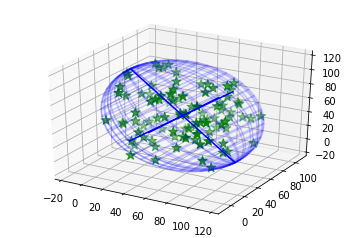

In [27]:
# make 100 random points
P = np.reshape([random()*100 for i in range(300)],(100,3))

# find the ellipsoid
ET = EllipsoidTool()
(center, radii, rotation) = ET.getMinVolEllipse(P, .01)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# plot points
ax.scatter(P[:,0], P[:,1], P[:,2], color='g', marker='*', s=100)

# plot ellipsoid
ET.plotEllipsoid(center, radii, rotation, ax=ax, plotAxes=True)

# plt.show()

### 111

In [23]:
x = df_111['Position X']
y = df_111['Position Y']
z = df_111['Position Z']

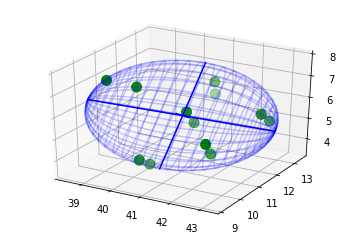

In [24]:
P = np.stack([x,y,z]).transpose()

# find the ellipsoid
ET = EllipsoidTool()
(center, radii, rotation) = ET.getMinVolEllipse(P, .01)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# plot points
ax.scatter(P[:,0], P[:,1], P[:,2], color='g', marker='o', s=100)

# plot ellipsoid
ET.plotEllipsoid(center, radii, rotation, ax=ax, plotAxes=True)

# plt.show()

-60 30 10


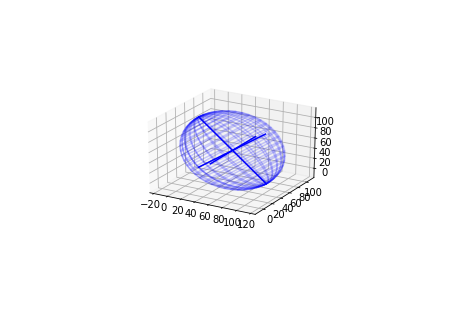

In [53]:
# make_ax = ax == None
# if make_ax:
#     fig = plt.figure()
#     ax = fig.add_subplot(111, projection='3d')
plotAxes = True
cageColor='b'
cageAlpha=0.2

fig = plt.figure()
ax = Axes3D(fig)

u = np.linspace(0.0, 2.0 * np.pi, 100)
v = np.linspace(0.0, np.pi, 100)

# cartesian coordinates that correspond to the spherical angles:
x = radii[0] * np.outer(np.cos(u), np.sin(v))
y = radii[1] * np.outer(np.sin(u), np.sin(v))
z = radii[2] * np.outer(np.ones_like(u), np.cos(v))
# rotate accordingly
for i in range(len(x)):
    for j in range(len(x)):
        [x[i,j],y[i,j],z[i,j]] = np.dot([x[i,j],y[i,j],z[i,j]], rotation) + center

if plotAxes:
    # make some purdy axes
    axes = np.array([[radii[0],0.0,0.0],
                     [0.0,radii[1],0.0],
                     [0.0,0.0,radii[2]]])
    # rotate accordingly
    for i in range(len(axes)):
        axes[i] = np.dot(axes[i], rotation)


    # plot axes
    for p in axes:
        X3 = np.linspace(-p[0], p[0], 100) + center[0]
        Y3 = np.linspace(-p[1], p[1], 100) + center[1]
        Z3 = np.linspace(-p[2], p[2], 100) + center[2]
        ax.plot(X3, Y3, Z3, color=cageColor)

# plot ellipsoid
ax.plot_wireframe(x, y, z,  rstride=4, cstride=4, color=cageColor, alpha=cageAlpha)
        
# ax.azim += 1    
# elev = 0.    
# for ii in range(0,360,1):
#     ax.view_init(elev=elev, azim=ii)
#         savefig("movie%d.png" % ii)
print(ax.azim, ax.elev, ax.dist)

ax.elev = 30. # angle between the eye and the xy plane.
ax.azim = -60 # rotation around the z axis; 0 means "looking from +x", 90 means "looking from +y"
ax.dist = 20 # distance from the center visible point in data coordinates.

In [346]:
u = np.linspace(0.0, 2.0 * np.pi, 100)
v = np.linspace(0.0, np.pi, 100)
        
# cartesian coordinates that correspond to the spherical angles:
x2 = radii[0] * np.outer(np.cos(u), np.sin(v))
y2 = radii[1] * np.outer(np.sin(u), np.sin(v))
z2 = radii[2] * np.outer(np.ones_like(u), np.cos(v))
# rotate accordingly
for i in range(len(x2)):
    for j in range(len(x2)):
        [x2[i,j],y2[i,j],z2[i,j]] = np.dot([x2[i,j],y2[i,j],z2[i,j]], rotation) + center
    
fig = go.Figure(
        data=[
            go.Surface(x=x2, y=y2, z=z2, 
                   opacity=0.3, 
                    showscale=False,
                   colorscale=[[0, 'green'], [1,'green']]
                  ),
            go.Scatter3d(
                x=x, y=y, z=z, 
                mode='markers+text',
                marker=dict(
                    size=3,
                    opacity=1,
                    color='red'
                ),
                text = list(range(len(x)))
            ),
            go.Scatter3d(
                x=x2.flatten(), y=y2.flatten(), z=z2.flatten(), 
                mode='lines',
                marker=dict(
                    size=1,
                    opacity=0.9,
                    color='yellow'
                )
            )
        ]
    )

# make some purdy axes
axes = np.array([[radii[0],0.0,0.0],
                 [0.0,radii[1],0.0],
                 [0.0,0.0,radii[2]]])
# rotate accordingly
for i in range(len(axes)):
    axes[i] = np.dot(axes[i], rotation)


# plot axes
for p in axes:
    X3 = np.linspace(-p[0], p[0], 100) + center[0]
    Y3 = np.linspace(-p[1], p[1], 100) + center[1]
    Z3 = np.linspace(-p[2], p[2], 100) + center[2]
    fig.add_trace(
        go.Scatter3d(x=X3, y=Y3, z=Z3, 
                     marker=dict(
                        size=1,
                        opacity=0.9,
                        color='black'
                    ))
    )
#     ax.plot(X3, Y3, Z3, color=cageColor)

fig.update_traces(showlegend=False)
fig.show()    
    
# if plotAxes:
#     # make some purdy axes
#     axes = np.array([[radii[0],0.0,0.0],
#                      [0.0,radii[1],0.0],
#                      [0.0,0.0,radii[2]]])
#     # rotate accordingly
#     for i in range(len(axes)):
#         axes[i] = np.dot(axes[i], rotation)


#     # plot axes
#     for p in axes:
#         X3 = np.linspace(-p[0], p[0], 100) + center[0]
#         Y3 = np.linspace(-p[1], p[1], 100) + center[1]
#         Z3 = np.linspace(-p[2], p[2], 100) + center[2]
#         ax.plot(X3, Y3, Z3, color=cageColor)
    
# # plot ellipsoid
# ax.plot_wireframe(x, y, z,  rstride=4, cstride=4, color=cageColor, alpha=cageAlpha)


In [347]:
ET.getEllipsoidVolume(radii)

39.06762610961019